In [453]:
# основа
import pandas as pd
import numpy as np
# визуализация
import matplotlib.pyplot as plt
# прогнозирование
from statsmodels.tsa.api import ExponentialSmoothing, SimpleExpSmoothing, Holt

## Rename_regions

In [478]:
# Функция, чтобы переименновывать регионы в большинстве таблиц
def rename_regions(regions):
    key_words = ['Тюменская', 'Архангельская', 
                 'Севастополь', 'Москва', 'Петербург',
                 'Кемеровская', 'Ненецкий','Ханты-Мансийский','Ямало-Ненецкий',
                 'Адыгея','Татарстан','Чувашская','Осетия','Кабардино',
                 'Карачаево', 'Владимирская', 'Волгоградская', 'Воронежская',
                 'Еврейск', ' Саха', 'Новгородская']
    true_names = ['Тюменская область (без автономных округов)',
                'Архангельская область (кроме Ненецкого автономного округа)',
                'город Севастополь',
                'город Москва',
                'город Санкт-Петербург',
                'Кемеровская область - Кузбасс',
                'Ненецкий автономный округ (Архангельская область)',
                'Ханты-Мансийский автономный округ - Югра (Тюменская область)',
                'Ямало-Ненецкий автономный округ (Тюменская область)',
                'Республика Адыгея (Адыгея)',
                'Республика Татарстан (Татарстан)',
                'Чувашская Республика - Чувашия',
                'Республика Северная Осетия-Алания',
                'Кабардино-Балкарская Республика',
                'Карачаево-Черкесская Республика',
                'Владимирская область',
                'Волгоградская область',
                'Воронежская область',
                'Еврейская автономная область',
                'Республика Саха (Якутия)',
                'Новгородская область']
    key_dict = dict()
    for i in range(len(key_words)):
        key_dict[key_words[i]] = true_names[i]
        
    replace_dict = dict()
    for region in regions:
        for key in key_words:
            if key in region:
                replace_dict[region] = key_dict[key]
    return replace_dict

## child_mortality_rural

In [489]:
child_mortality_rural = pd.read_excel('data/social_russia_data/child_mortality_rural_1990_2021.xls')
child_mortality_rural.head()

,"Число умерших на первом году жизни детей за год (человек, значение показателя за год)",Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,1990.0,1991.0,1992.0,1993.0,1994.0,1995.0,1996.0,...,2012.0,2013.0,2014.0,2015.0,2016.0,2017.0,2018.0,2019.0,2020.0,2021.0
2,Российская Федерация,Оба пола,сельское население,11186.0,10943.0,10111.0,9840.0,9010.0,8582.0,7983.0,...,5463.0,5059.0,4681.0,4165.0,3568.0,3032.0,2521.0,2122.0,1916.0,1852.0
3,Центральный федеральный округ,Оба пола,сельское население,1615.0,1550.0,1361.0,1426.0,1347.0,1321.0,1200.0,...,625.0,608.0,487.0,490.0,426.0,347.0,291.0,211.0,228.0,212.0
4,Белгородская область,Оба пола,сельское население,103.0,92.0,75.0,79.0,80.0,72.0,72.0,...,43.0,48.0,41.0,42.0,36.0,34.0,33.0,16.0,22.0,20.0


Преобразуем названия столюцов и избавляемся от ненужных строчек

In [490]:
cols = list(child_mortality_rural.loc[1].values)
cols[0:3] = ['Название территории', 'Пол', 'Тип населения']
child_mortality_rural.columns = cols

In [491]:
child_mortality_rural = child_mortality_rural.drop([0,1], axis=0)
child_mortality_rural = child_mortality_rural.drop(['Пол', 'Тип населения'], axis=1)

In [492]:
child_mortality_rural = child_mortality_rural.reset_index(drop=True)
child_mortality_rural.head()

,Название территории,1990.0,1991.0,1992.0,1993.0,1994.0,1995.0,1996.0,1997.0,1998.0,...,2012.0,2013.0,2014.0,2015.0,2016.0,2017.0,2018.0,2019.0,2020.0,2021.0
0,Российская Федерация,11186.0,10943.0,10111.0,9840.0,9010.0,8582.0,7983.0,7701.0,7214.0,...,5463.0,5059.0,4681.0,4165.0,3568.0,3032.0,2521.0,2122.0,1916.0,1852.0
1,Центральный федеральный округ,1615.0,1550.0,1361.0,1426.0,1347.0,1321.0,1200.0,NaN,NaN,...,625.0,608.0,487.0,490.0,426.0,347.0,291.0,211.0,228.0,212.0
2,Белгородская область,103.0,92.0,75.0,79.0,80.0,72.0,72.0,67.0,61.0,...,43.0,48.0,41.0,42.0,36.0,34.0,33.0,16.0,22.0,20.0
3,Брянская область,124.0,109.0,83.0,121.0,99.0,104.0,96.0,67.0,75.0,...,46.0,47.0,39.0,44.0,36.0,31.0,12.0,11.0,12.0,13.0
4,Владимирская область,80.0,58.0,60.0,62.0,46.0,50.0,47.0,38.0,39.0,...,30.0,31.0,23.0,31.0,28.0,17.0,22.0,15.0,10.0,14.0


Убираем федеральные округи

In [493]:
mask = []
for i in child_mortality_rural.index:
    mask.append(not ('федеральный округ' in child_mortality_rural['Название территории'].loc[i])) 
child_mortality_rural = child_mortality_rural.loc[mask].reset_index(drop=True)

Работа с автономными регионами

In [494]:
child_mortality_rural['Название территории'] = child_mortality_rural['Название территории'].apply(lambda x:
                                                                                        x.replace('  ',''))

In [495]:
df = child_mortality_rural.T
df.columns = df.loc['Название территории'].values
df = df.drop('Название территории', axis=0)
child_mortality_rural = df

In [496]:
child_mortality_rural['Архангельская область (кроме Ненецкого автономного округа)'] = (
    child_mortality_rural['Архангельская область'] 
    - child_mortality_rural['Ненецкий автономный округ (Архангельская область)']
    )
child_mortality_rural = child_mortality_rural.drop('Архангельская область', axis=1)

In [497]:
child_mortality_rural['Ханты-Мансийский автономный округ - Югра (Тюменская область)'][2021] = 9
child_mortality_rural['Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)'] = (
    child_mortality_rural['Тюменская область'] 
    - child_mortality_rural['Ханты-Мансийский автономный округ - Югра (Тюменская область)']
    - child_mortality_rural['Ямало-Ненецкий автономный округ (Тюменская область)']
    )
child_mortality_rural = child_mortality_rural.drop('Тюменская область', axis=1)

### Работа с пропусками

In [498]:
regions_with_nans = child_mortality_rural.isna().sum().loc[child_mortality_rural.isna().sum()!=0]
regions_with_nans

Город Москва столица Российской Федерации город федерального значения    15
Город Санкт-Петербург город федерального значения                        16
Республика Крым                                                          25
Город федерального значения Севастополь                                  25
Чеченская Республика                                                      3
Коми-Пермяцкий округ, входящий в состав Пермского края                   13
Таймырский (Долгано-Ненецкий) автономный округ (Красноярский край)       11
Эвенкийский автономный округ (Красноярский край)                         11
Усть-Ордынский Бурятский округ                                           11
Агинский Бурятский округ (Забайкальский край)                            11
Корякский округ, входящий в состав Камчатского края                      11
Чеченская и Ингушская Республики                                         29
Северный район                                                           22
Северо-Запад

In [499]:
# Заполним пропуски (так же нули) в Чеченской республике интерполяцией
child_mortality_rural.loc[1993:2003,'Чеченская Республика'] = np.NAN
child_mortality_rural['Чеченская Республика'] = child_mortality_rural['Чеченская Республика'].astype('float').interpolate()

In [500]:
# Удаляем остальные регионы с пропусками кроме Крыма и Севастополя
regions_with_nans = child_mortality_rural.isna().sum().loc[child_mortality_rural.isna().sum()!=0]
regions_with_nans = list(regions_with_nans.index)
regions_with_nans.remove('Республика Крым')
regions_with_nans.remove('Город федерального значения Севастополь')
child_mortality_rural = child_mortality_rural.drop(regions_with_nans, axis=1)

In [501]:
# Пропуски остались только в начальных датах. 
# Они не страшны, т.к. мы будем делать предсказания по имеющимся данным на 2023-ий год
child_mortality_rural[child_mortality_rural.isna().sum().loc[child_mortality_rural.isna().sum()!=0].index]

,Республика Крым,Город федерального значения Севастополь
1990.0,NaN,NaN
1991.0,NaN,NaN
1992.0,NaN,NaN
1993.0,NaN,NaN
1994.0,NaN,NaN
1995.0,NaN,NaN
1996.0,NaN,NaN
1997.0,NaN,NaN
1998.0,NaN,NaN
1999.0,NaN,NaN


In [502]:
rename_regions(child_mortality_rural.columns)

{'Владимирская область': 'Владимирская область',
 'Воронежская область': 'Воронежская область',
 'Ненецкий автономный округ (Архангельская область)': 'Ненецкий автономный округ (Архангельская область)',
 'Архангельская область (кроме Ненецкого автономного округа)': 'Архангельская область (кроме Ненецкого автономного округа)',
 'Новгородская область': 'Новгородская область',
 'Республика Адыгея (Адыгея)': 'Республика Адыгея (Адыгея)',
 'Волгоградская область': 'Волгоградская область',
 'Город федерального значения Севастополь': 'город Севастополь',
 'Кабардино-Балкарская Республика': 'Кабардино-Балкарская Республика',
 'Карачаево-Черкесская Республика': 'Карачаево-Черкесская Республика',
 'Республика Северная Осетия-Алания': 'Республика Северная Осетия-Алания',
 'Республика Татарстан (Татарстан)': 'Республика Татарстан (Татарстан)',
 'Чувашская Республика - Чувашия': 'Чувашская Республика - Чувашия',
 'Ханты-Мансийский автономный округ - Югра (Тюменская область)': 'Ханты-Мансийский авто

In [503]:
# Переименновываем столбцы для финальной таблицы
child_mortality_rural = child_mortality_rural.rename(columns=rename_regions(child_mortality_rural.columns))

In [504]:
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [505]:
set(final_df.index) - set(child_mortality_rural.columns)

{'город Москва', 'город Санкт-Петербург'}

In [506]:
set(child_mortality_rural.columns) - set(final_df.index)

set()

### Проверка на выбросы

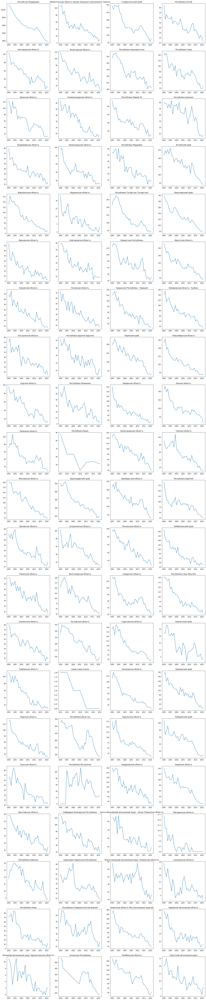

In [17]:
fig, axs = plt.subplots(21,4, figsize=(24,123))
for i, col in enumerate(child_mortality_rural.columns):
    if i<21:
        axs[i,0].plot(child_mortality_rural[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(child_mortality_rural[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(child_mortality_rural[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(child_mortality_rural[col])
        axs[i-63,3].set_title(col)
plt.show()

In [18]:
child_mortality_rural.to_csv('data/child_mortality_rural.csv')

## child_mortality_urban

In [522]:
child_mortality_urban = pd.read_excel('data/social_russia_data/child_mortality_urban_1990_2021.xls')
child_mortality_urban

,"Число умерших на первом году жизни детей за год (человек, значение показателя за год)",Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,1990.0,1991.0,1992.0,1993.0,1994.0,1995.0,1996.0,...,2012.0,2013.0,2014.0,2015.0,2016.0,2017.0,2018.0,2019.0,2020.0,2021.0
2,Российская Федерация,Оба пола,городское население,23902.0,21549.0,19097.0,18106.0,17131.0,16258.0,14842.0,...,10843.0,10418.0,9641.0,8499.0,7860.0,6545.0,5723.0,5206.0,4573.0,4664.0
3,Центральный федеральный округ,Оба пола,городское население,5317.0,4734.0,4175.0,3899.0,3871.0,3631.0,3254.0,...,2789.0,2735.0,2402.0,2228.0,2146.0,1785.0,1593.0,1409.0,1153.0,1192.0
4,Белгородская область,Оба пола,городское население,209.0,198.0,165.0,165.0,153.0,131.0,102.0,...,84.0,68.0,62.0,68.0,72.0,43.0,40.0,23.0,25.0,34.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,Северо-Кавказский район,Оба пола,городское население,2591.0,2594.0,2433.0,2112.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
117,Уральский район,Оба пола,городское население,3402.0,3044.0,2707.0,2626.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
118,Западно-Сибирский район,Оба пола,городское население,2645.0,2404.0,2132.0,2095.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
119,Восточно-Сибирский район,Оба пола,городское население,1898.0,1794.0,1498.0,1518.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [523]:
# Меняем названия столбцов
cols = list(child_mortality_urban.loc[1].values)
cols[0:3] = ['Название территории', 'Пол', 'Тип населения']
child_mortality_urban.columns = cols

In [524]:
# Удаляем пустые строчки и ненужные столбцы
child_mortality_urban = child_mortality_urban.drop([0,1], axis=0)
child_mortality_urban = child_mortality_urban.drop(['Пол', 'Тип населения'], axis=1)

In [525]:
child_mortality_urban = child_mortality_urban.reset_index(drop=True)
child_mortality_urban.head()

,Название территории,1990.0,1991.0,1992.0,1993.0,1994.0,1995.0,1996.0,1997.0,1998.0,...,2012.0,2013.0,2014.0,2015.0,2016.0,2017.0,2018.0,2019.0,2020.0,2021.0
0,Российская Федерация,23902.0,21549.0,19097.0,18106.0,17131.0,16258.0,14842.0,14034.0,13883.0,...,10843.0,10418.0,9641.0,8499.0,7860.0,6545.0,5723.0,5206.0,4573.0,4664.0
1,Центральный федеральный округ,5317.0,4734.0,4175.0,3899.0,3871.0,3631.0,3254.0,NaN,NaN,...,2789.0,2735.0,2402.0,2228.0,2146.0,1785.0,1593.0,1409.0,1153.0,1192.0
2,Белгородская область,209.0,198.0,165.0,165.0,153.0,131.0,102.0,100.0,99.0,...,84.0,68.0,62.0,68.0,72.0,43.0,40.0,23.0,25.0,34.0
3,Брянская область,198.0,195.0,200.0,176.0,157.0,125.0,116.0,135.0,107.0,...,81.0,77.0,87.0,67.0,67.0,65.0,33.0,26.0,29.0,14.0
4,Владимирская область,221.0,209.0,179.0,148.0,165.0,146.0,114.0,123.0,130.0,...,97.0,86.0,87.0,76.0,72.0,59.0,45.0,43.0,51.0,52.0


In [526]:
# Удаляем федеральные округи
mask = []
for i in child_mortality_urban.index:
    mask.append(not ('федеральный округ' in child_mortality_urban['Название территории'].loc[i]))
child_mortality_urban = child_mortality_urban.loc[mask].reset_index(drop=True)

In [527]:
# Убираем лишние отступы в названиях
child_mortality_urban['Название территории'] = child_mortality_urban['Название территории'].apply(lambda x:
                                                                                        x.replace('  ',''))

In [528]:
# Транспонируем таблицу
df = child_mortality_urban.T
df.columns = df.loc['Название территории'].values
df = df.drop('Название территории', axis=0)
child_mortality_urban = df

In [529]:
# Заполняем Архангельскую область
child_mortality_urban['Архангельская область (кроме Ненецкого автономного округа)'] = (
    child_mortality_urban['Архангельская область'] 
    - child_mortality_urban['Ненецкий автономный округ (Архангельская область)']
    )
child_mortality_urban = child_mortality_urban.drop('Архангельская область', axis=1)

In [530]:
# Заполняем Тюменскую область
child_mortality_urban['Ханты-Мансийский автономный округ - Югра (Тюменская область)'][2021] = 9
child_mortality_urban['Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)'] = (
    child_mortality_urban['Тюменская область'] 
    - child_mortality_urban['Ханты-Мансийский автономный округ - Югра (Тюменская область)']
    - child_mortality_urban['Ямало-Ненецкий автономный округ (Тюменская область)']
    )
child_mortality_urban = child_mortality_urban.drop('Тюменская область', axis=1)

In [531]:
# Заполним пропуски (так же нули) в Чеченской республике интерполяцией
child_mortality_urban.loc[1993:2003,'Чеченская Республика'] = np.NAN
child_mortality_urban['Чеченская Республика'] = child_mortality_urban['Чеченская Республика'].astype('float').interpolate()

In [532]:
# Удаляем остальные регионы с пропусками кроме Крыма и Севастополя
regions_with_nans = child_mortality_urban.isna().sum().loc[child_mortality_urban.isna().sum()!=0]
regions_with_nans = list(regions_with_nans.index)
regions_with_nans.remove('Республика Крым')
regions_with_nans.remove('Город федерального значения Севастополь')
child_mortality_urban = child_mortality_urban.drop(regions_with_nans, axis=1)

In [533]:
# Пропуски остались только в начальных датах. 
# Они не страшны, т.к. мы будем делать предсказания по имеющимся данным на 2023-ий год
child_mortality_urban[child_mortality_urban.isna().sum().loc[child_mortality_urban.isna().sum()!=0].index]

,Республика Крым,Город федерального значения Севастополь
1990.0,NaN,NaN
1991.0,NaN,NaN
1992.0,NaN,NaN
1993.0,NaN,NaN
1994.0,NaN,NaN
1995.0,NaN,NaN
1996.0,NaN,NaN
1997.0,NaN,NaN
1998.0,NaN,NaN
1999.0,NaN,NaN


In [534]:
# Переименновываем столбцы
child_mortality_urban = child_mortality_urban.rename(columns=rename_regions(child_mortality_urban.columns))

In [535]:
regions = child_mortality_urban.columns
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [536]:
child_mortality_urban.to_csv('data/child_mortality_urban.csv')

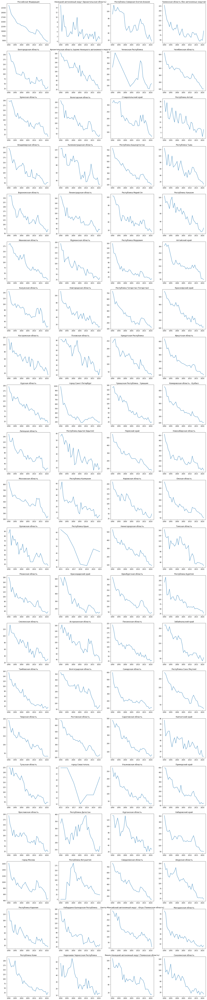

In [521]:
fig, axs = plt.subplots(21,4, figsize=(24,123))
for i, col in enumerate(child_mortality_urban.columns):
    if i<21:
        axs[i,0].plot(child_mortality_urban[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(child_mortality_urban[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(child_mortality_urban[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(child_mortality_urban[col])
        axs[i-63,3].set_title(col)
plt.show()

## population

In [537]:
population = pd.read_excel('data/social_russia_data/population.xlsx')
population.head()

,Unnamed: 0,Unnamed: 1,23110000100030200002 Численность постоянного населения на 1 января,23110000100030200002 Численность постоянного населения на 1 января.1,23110000100030200002 Численность постоянного населения на 1 января.2,23110000100030200002 Численность постоянного населения на 1 января.3,23110000100030200002 Численность постоянного населения на 1 января.4,23110000100030200002 Численность постоянного населения на 1 января.5,23110000100030200002 Численность постоянного населения на 1 января.6,23110000100030200002 Численность постоянного населения на 1 января.7,...,23110000100030200002 Численность постоянного населения на 1 января.14,23110000100030200002 Численность постоянного населения на 1 января.15,23110000100030200002 Численность постоянного населения на 1 января.16,23110000100030200002 Численность постоянного населения на 1 января.17,23110000100030200002 Численность постоянного населения на 1 января.18,23110000100030200002 Численность постоянного населения на 1 января.19,23110000100030200002 Численность постоянного населения на 1 января.20,23110000100030200002 Численность постоянного населения на 1 января.21,23110000100030200002 Численность постоянного населения на 1 января.22,23110000100030200002 Численность постоянного населения на 1 января.23
0,NaN,NaN,январь 1999 г.,январь 2000 г.,январь 2001 г.,январь 2002 г.,январь 2003 г.,январь 2004 г.,январь 2005 г.,январь 2006 г.,...,январь 2013 г.,январь 2014 г.,январь 2015 г.,январь 2016 г.,январь 2017 г.,январь 2018 г.,январь 2019 г.,январь 2020 г.,январь 2021 г.,январь 2022 г.
1,все население,w2:p_mest:11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Российская Федерация,643,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Раздел 1. Муниципальные образования субъектов ...,00000000000,147539426,146890128,146303611,145649334,144963650,144333586,143801046,143236582,...,143347059,143666931,146267288,146544710,146804372,146880432,146780720,146748590,146171015,145557576
4,Центральный федеральный округ,030,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [538]:
# Меняем названия столбцов
cols = list(population.loc[0].values)
for i in range(len(cols)):
    if i==0: 
        cols[i] = 'Territory'
    elif i==1:
        cols[i] = 'Number'
    else:
        cols[i] = int(cols[i].split()[1])
population.columns = cols

In [539]:
# Удаляем столбец с непонятным номером
population = population.drop('Number', axis=1)
population = population.drop(0,axis=0).reset_index(drop=True)

In [540]:
# Заменяем строчки с надписью "Раздел 1" на название территории выше.
for i in range(population.shape[0]):
    if population['Territory'][i].split('.')[0] == 'Раздел 1':
        population['Territory'][i] = population['Territory'][i-1]
        population = population.drop(i-1, axis=0)

In [541]:
population = population.reset_index(drop=True)

In [542]:
# Удаляем федеральные округи 
mask = []
for i in population.index:
    mask.append(not ('федеральный округ' in population['Territory'].loc[i]))
population = population.loc[mask].reset_index(drop=True)

In [543]:
# Транспонируем таблицу
df = population.T
df.columns = df.loc['Territory'].values
df = df.drop('Territory', axis=0)
population = df

In [544]:
# Отделяем Архангельскую область от автономных округов
population['Архангельская область (кроме Ненецкого автономного округа)'] = (
    population['Архангельская область'] - 
    population['Ненецкий автономный округ (Архангельская область)']
)
population = population.drop('Архангельская область', axis=1)

In [545]:
# Отделяем Тюменскую область от автономных округов
population['Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)'] = (
    population['Тюменская область'] 
    - population['Ханты-Мансийский автономный округ - Югра (Тюменская область)']
    - population['Ямало-Ненецкий автономный округ (Тюменская область)']
    )
population = population.drop('Тюменская область', axis=1)

In [546]:
population.isna().sum().loc[population.isna().sum()!=0]

все население                                                         24
Республика Крым                                                       16
Город федерального значения Севастополь                               16
Коми-Пермяцкий округ, входящий в состав Пермского края                20
Муниципальные образования Алтайского края                             18
                                                                      ..
Агинский Бурятский округ (Забайкальский край)                         20
Таймырский (Долгано-Ненецкий) автономный округ (Красноярский край)    20
Эвенкийский автономный округ (Красноярский край)                      20
Усть-Ордынский Бурятский округ                                        20
Корякский округ, входящий в состав Камчатского края                   20
Length: 162, dtype: int64

In [547]:
# Удаляем остальные регионы с пропусками кроме Крыма и Севастополя
regions_with_nans = population.isna().sum().loc[population.isna().sum()!=0]
regions_with_nans = list(regions_with_nans.index)
regions_with_nans.remove('Республика Крым')
regions_with_nans.remove('Город федерального значения Севастополь')
population = population.drop(regions_with_nans, axis=1)

In [548]:
population.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24 entries, 1999 to 2022
Data columns (total 86 columns):
 #   Column                                                                                                    Non-Null Count  Dtype 
---  ------                                                                                                    --------------  ----- 
 0   Российская Федерация                                                                                      24 non-null     object
 1   Белгородская область                                                                                      24 non-null     object
 2   Брянская область                                                                                          24 non-null     object
 3   Владимирская область                                                                                      24 non-null     object
 4   Воронежская область                                                                     

In [549]:
population = population.rename(columns=rename_regions(population.columns))

In [550]:
regions = population.columns
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [551]:
# Проверим на нули, чтобы исключить замаскированные пропуски
(population==0).sum().sum()

0

In [552]:
population.to_csv('data/population.csv')

In [ ]:
fig, axs = plt.subplots(21,4, figsize=(24,123))
for i, col in enumerate(population.columns):
    if i<21:
        axs[i,0].plot(population[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(population[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(population[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(population[col])
        axs[i-63,3].set_title(col)
plt.show()

## newborn

In [553]:
newborn = pd.read_csv('data/social_russia_data/newborn_2006_2022_monthly.csv', sep=';')
newborn

,Region,январь 2006 г.,февраль 2006 г.,март 2006 г.,апрель 2006 г.,май 2006 г.,июнь 2006 г.,июль 2006 г.,август 2006 г.,сентябрь 2006 г.,...,сентябрь 2021 г.,октябрь 2021 г.,ноябрь 2021 г.,декабрь 2021 г.,январь 2022 г.,февраль 2022 г.,март 2022 г.,апрель 2022 г.,май 2022 г.,Unnamed: 198
0,Российская Федерация,109422,"114068,99","129177,99","113391,99","125099,99",124238,"125926,99","140227,99","123949,99",...,"121645,99","120080,99","114976,99","117945,99",103782,101082,115512,"99696,99",103159,NaN
1,Центральный федеральный округ,"24998,99","25539,99","29558,99",25781,29137,28837,"28997,99","31590,99","27755,99",...,29727,"29532,99",29093,29477,25827,25678,28086,"24979,99",26304,NaN
2,Белгородская область,1040,1094,1190,1044,1228,1249,1224,1389,1157,...,1084,1053,990,1028,861,941,956,801,869,NaN
3,Брянская область,904,989,1039,936,1072,961,1058,1121,989,...,784,751,783,729,707,670,740,589,660,NaN
4,Владимирская область,1040,1059,1236,1063,1226,1144,1221,1333,1177,...,783,834,769,821,691,700,708,660,711,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,Еврейская автономная область,176,169,215,141,168,182,218,225,196,...,164,119,139,133,120,115,136,94,115,NaN
105,Чукотский автономный округ,44,77,60,53,57,59,86,58,64,...,24,54,35,40,42,36,57,38,37,NaN
106,Крымский федеральный округ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
107,Московская обл. в старых границах,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [554]:
# Удаляем федеральные округи 
mask = []
for i in newborn.index:
    mask.append(not ('федеральный округ' in newborn['Region'].loc[i]))
newborn = newborn.loc[mask].reset_index(drop=True)

In [555]:
# Удаляем пустой столбец
newborn = newborn.drop(newborn.columns[-1],axis=1)

In [556]:
# складываем значение по месяцам
years_set = set()
for col in newborn.columns:
    if len(col.split())>1:
        years_set.add(col.split()[1])

for year in years_set:
    newborn[year] = [0 for i in range(newborn.shape[0])]
    for col in newborn.columns[1:]:
        if len(col.split()) > 1:
            if col.split()[1] == year:
                newborn[year] += newborn[col].apply(lambda x: float(x.replace(',','.')) if type(x)==str else x)
                newborn = newborn.drop(col,axis=1)

In [557]:
# Переводим года в числовой формат
cols = ['Region']
for col in newborn.columns[1:]:
     cols.append(int(col))
newborn.columns = cols

In [558]:
# Транспонируем таблицу
df = newborn.T
df.columns = df.loc['Region'].values
df = df.drop('Region', axis=0)
newborn = df

In [559]:
# Отделяем Архангельскую область от автономных округов
newborn['Архангельская область (кроме Ненецкого автономного округа)'] = (
    newborn['Архангельская область'] - 
    newborn['Ненецкий автономный округ (Архангельская область)']
)
newborn = newborn.drop('Архангельская область', axis=1)

In [560]:
# Отделяем Тюменскую область от автономных округов
newborn['Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)'] = (
    newborn['Тюменская область'] 
    - newborn['Ханты-Мансийский автономный округ - Югра (Тюменская область)']
    - newborn['Ямало-Ненецкий автономный округ (Тюменская область)']
    )
newborn = newborn.drop('Тюменская область', axis=1)

In [561]:
newborn.isna().sum().loc[newborn.isna().sum()!=0]

Республика Крым                                                        9
Город федерального значения Севастополь                                9
Коми-Пермяцкий округ, входящий в состав Пермского края                13
Агинский Бурятский округ (Забайкальский край)                         12
Таймырский (Долгано-Ненецкий) автономный округ (Красноярский край)    12
Эвенкийский автономный округ (Красноярский край)                      12
Усть-Ордынский Бурятский округ                                        12
Корякский округ, входящий в состав Камчатского края                   12
Московская обл. в старых границах                                     14
Москва в старых границах                                              14
dtype: int64

In [562]:
# Удаляем остальные регионы с пропусками кроме Крыма и Севастополя
regions_with_nans = newborn.isna().sum().loc[newborn.isna().sum()!=0]
regions_with_nans = list(regions_with_nans.index)
regions_with_nans.remove('Республика Крым')
regions_with_nans.remove('Город федерального значения Севастополь')
newborn = newborn.drop(regions_with_nans, axis=1)

In [563]:
newborn = newborn.rename(columns=rename_regions(newborn.columns))

In [564]:
regions = newborn.columns
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [565]:
# Сортируем под годам
newborn = newborn.sort_index()

In [566]:
# Проверяем на замаскированые под 0 пропуски
(newborn==0).sum().sum()

0

In [567]:
newborn.to_csv('data/newborn.csv')

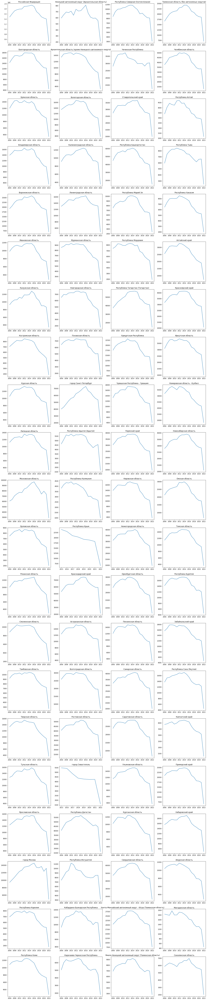

In [568]:

fig, axs = plt.subplots(21,4, figsize=(24,123))
for i, col in enumerate(newborn.columns):
    if i<21:
        axs[i,0].plot(newborn[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(newborn[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(newborn[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(newborn[col])
        axs[i-63,3].set_title(col)
plt.show()

## child_mortality_coefficient

In [569]:
# Будем суммировать данные из смертности младенцев и делить сумму на данные о рождаемости
child_mortality_rural = pd.read_csv('data/child_mortality_rural.csv', index_col='Unnamed: 0')
child_mortality_urban = pd.read_csv('data/child_mortality_urban.csv', index_col='Unnamed: 0')
newborn = pd.read_csv('data/newborn.csv', index_col='Unnamed: 0')

In [570]:
# Суммируем данные по регионам (По Москве и Петербургу есть только городское население)
child_mortality = pd.DataFrame()
for col in child_mortality_rural.columns:
    child_mortality[col] = child_mortality_rural[col] + child_mortality_urban[col]
child_mortality['город Москва'] = child_mortality_urban['город Москва']
child_mortality['город Санкт-Петербург'] = child_mortality_urban['город Санкт-Петербург']
child_mortality.head()

,Российская Федерация,Белгородская область,Брянская область,Владимирская область,Воронежская область,Ивановская область,Калужская область,Костромская область,Курская область,Липецкая область,...,Камчатский край,Приморский край,Хабаровский край,Амурская область,Магаданская область,Сахалинская область,Еврейская автономная область,Чукотский автономный округ,город Москва,город Санкт-Петербург
1990.0,35088.0,312.0,322.0,301.0,399.0,255.0,214.0,186.0,292.0,219.0,...,99.0,618.0,462.0,343.0,93.0,171.0,94.0,41.0,1617.0,991.0
1991.0,32492.0,290.0,304.0,267.0,441.0,231.0,192.0,162.0,251.0,204.0,...,70.0,623.0,345.0,293.0,82.0,115.0,94.0,40.0,1351.0,800.0
1992.0,29208.0,240.0,283.0,239.0,418.0,214.0,179.0,155.0,240.0,199.0,...,81.0,521.0,301.0,280.0,55.0,120.0,85.0,44.0,1121.0,583.0
1993.0,27946.0,244.0,297.0,210.0,362.0,225.0,144.0,138.0,207.0,242.0,...,84.0,480.0,310.0,244.0,44.0,110.0,95.0,42.0,1056.0,618.0
1994.0,26141.0,233.0,256.0,211.0,348.0,192.0,155.0,134.0,236.0,189.0,...,78.0,473.0,299.0,242.0,44.0,118.0,76.0,22.0,1153.0,543.0


In [571]:
# Создаём таблицу с коэффициентами
child_mortality_coefficient = pd.DataFrame()
for col in child_mortality.columns:
    child_mortality_coefficient[col] = child_mortality.loc[2006:][col] / newborn.loc[:2021][col]
child_mortality_coefficient = child_mortality_coefficient*1000

In [572]:
child_mortality_coefficient.to_csv('data/child_mortality_coefficient.csv')

In [ ]:
fig, axs = plt.subplots(21,4, figsize=(24,123))
for i, col in enumerate(child_mortality_coefficient.columns):
    if i<21:
        axs[i,0].plot(child_mortality_coefficient[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(child_mortality_coefficient[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(child_mortality_coefficient[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(child_mortality_coefficient[col])
        axs[i-63,3].set_title(col)
plt.show()

## invalidity

In [573]:
invalidity = pd.read_csv('data/social_russia_data/disabled_total_by_age_2017_2022.csv')
invalidity

,region,total,18_30,31_40,41_50,51_60,60_,date
0,Российская Федерация,11640873.0,550895.0,766054.0,1030652.0,2135436.0,7157836.0,2017-01-01
1,Центральный федеральный округ,3420310.0,118579.0,172662.0,257484.0,598102.0,2273483.0,2017-01-01
2,Белгородская область,223030.0,6318.0,10383.0,16596.0,37444.0,152289.0,2017-01-01
3,Брянская область,110418.0,4215.0,6568.0,10230.0,21481.0,67924.0,2017-01-01
4,Владимирская область,133352.0,4454.0,6811.0,9606.0,23322.0,89159.0,2017-01-01
...,...,...,...,...,...,...,...,...
6075,Еврейская автономная область,11669.0,629.0,1167.0,1447.0,1624.0,6802.0,2022-04-01
6076,Чукотский автономный округ,1671.0,177.0,220.0,301.0,366.0,607.0,2022-04-01
6077,Республика Саха (Якутия),51362.0,4186.0,5536.0,6957.0,10118.0,24565.0,2022-04-01
6078,Приморский край,100734.0,4885.0,9090.0,12536.0,15527.0,58696.0,2022-04-01


In [574]:
# Удаляем федеральные округи 
mask = []
for i in invalidity.index:
    mask.append(not ('федеральный округ' in invalidity['region'].loc[i]))
invalidity = invalidity.loc[mask].reset_index(drop=True)

In [575]:
# Переводим дату в формат datetime
invalidity['date'] = pd.to_datetime(invalidity['date'])

Работа с пропусками

In [576]:
#Заполняем пропуски
invalidity.loc[1913,'18_30'] = invalidity['total'][1913]-invalidity['31_40'][1913]-invalidity['41_50'][1913]-invalidity['51_60'][1913]-invalidity['60_'][1913]

In [577]:
num_cols = list(invalidity.columns)
num_cols.remove('region')
num_cols.remove('date')
num_cols

['total', '18_30', '31_40', '41_50', '51_60', '60_']

In [578]:
invalidity[invalidity['18_30'].isna()]

,region,total,18_30,31_40,41_50,51_60,60_,date
384,Ставропольский край,NaN,NaN,NaN,NaN,NaN,NaN,2017-05-01
388,Краснодарский край,NaN,NaN,NaN,NaN,NaN,NaN,2017-05-01
416,Алтайский край,NaN,NaN,NaN,NaN,NaN,NaN,2017-05-01
421,Красноярский край,NaN,NaN,NaN,NaN,NaN,NaN,2017-05-01
425,Хабаровский край,NaN,NaN,NaN,NaN,NaN,NaN,2017-05-01
433,Приморский край,NaN,NaN,NaN,NaN,NaN,NaN,2017-05-01


In [579]:
for col in num_cols:
    for i in invalidity[invalidity[col].isna()].index:
        date_before = invalidity.loc[i]['date'] - pd.DateOffset(months=1)
        date_after = invalidity.loc[i]['date'] + pd.DateOffset(months=1)
        region = invalidity['region'][i]
        invalidity.loc[i,col] = round((
            invalidity[(invalidity['region']==region)&(invalidity['date']==date_after)][col].iloc[0] + 
            invalidity[(invalidity['region']==region)&(invalidity['date']==date_before)][col].iloc[0]
        ) / 2)

In [580]:
invalidity.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5568 entries, 0 to 5567
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   region  5568 non-null   object        
 1   total   5568 non-null   float64       
 2   18_30   5568 non-null   float64       
 3   31_40   5568 non-null   float64       
 4   41_50   5568 non-null   float64       
 5   51_60   5568 non-null   float64       
 6   60_     5568 non-null   float64       
 7   date    5568 non-null   datetime64[ns]
dtypes: datetime64[ns](1), float64(6), object(1)
memory usage: 348.1+ KB


### Проверка на выбросы

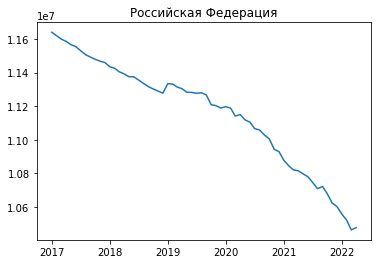

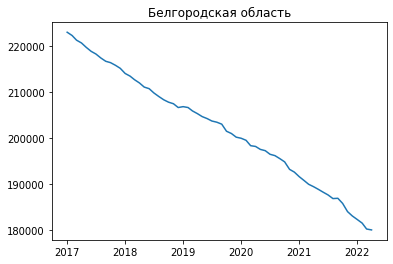

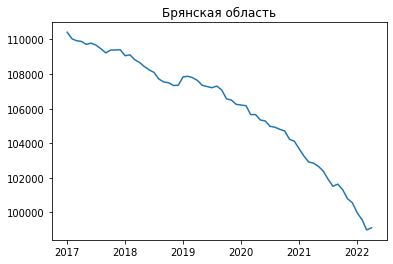

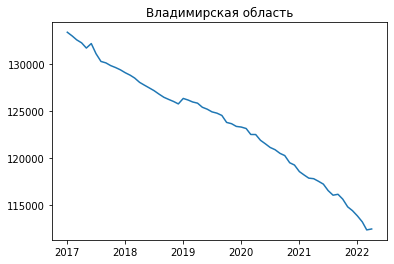

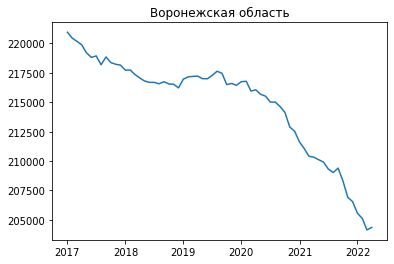

...

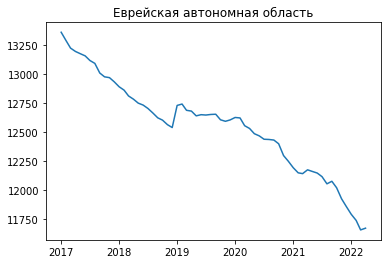

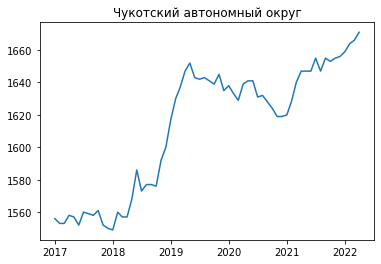

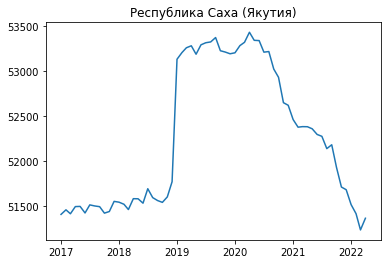

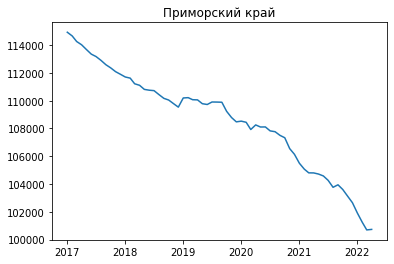

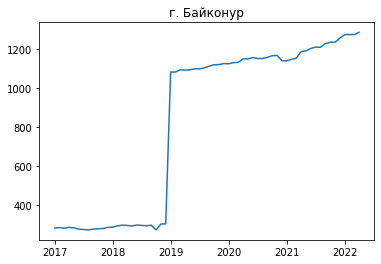

In [92]:
for region in invalidity['region'].unique():
    y = invalidity[invalidity['region']==region]['total']
    x = invalidity[invalidity['region']==region]['date']
    fig, ax = plt.subplots()
    ax.plot(x,y)
    ax.set_title(region)
    plt.show()

In [581]:
# Избавляемся от выбросов, заменив их на среднее значение между предыдущей и последующей датами
regions_with_outliers = ['Кемеровская область','Новосибирская область',
                         'Омская область','Томская область',
                         'Красноярский край','Иркутская область']
age_cols = list(invalidity.columns)
age_cols.remove('region')
age_cols.remove('date')
for region in regions_with_outliers:
    mask = (invalidity['region']==region)&(invalidity['date']==pd.Timestamp('2018-02-01'))
    index = invalidity[mask].index
    invalidity.loc[index,age_cols] = ((invalidity[(invalidity['region']==region)&(invalidity['date']==pd.Timestamp('2018-01-01'))][age_cols].iloc[0]+
                                invalidity[(invalidity['region']==region)&(invalidity['date']==pd.Timestamp('2018-03-01'))][age_cols].iloc[0]
                                )/2).values

**Подготавливаем данные для final_df**

In [582]:
# Убираем г. Байконур отдельно, по нему нет данных в других таблицах
invalidity_Baikonur = invalidity[invalidity['region']=='г. Байконур']
invalidity = invalidity.drop(invalidity_Baikonur.index)
invalidity = invalidity.reset_index(drop=True)

In [586]:
invalidity = invalidity.replace(rename_regions(invalidity['region'].unique()))

In [587]:
regions = invalidity['region'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [588]:
# Проверяем на замаскированные под 0 пропуски
(invalidity==0).sum().sum()

0

In [589]:
invalidity.to_csv('data/invalidity.csv')

## invalidity_coefficient

In [590]:
# Будем делить инвалидность на население
invalidity_coefficient = pd.read_csv('data/invalidity.csv', index_col='Unnamed: 0')
population = pd.read_csv('data/population.csv', index_col='Unnamed: 0')

In [591]:
# Составляем таблицу
# Отделяем возрастные группы в список
age_groups = list(invalidity_coefficient.columns)
age_groups.remove('region')
age_groups.remove('date')
for i in invalidity_coefficient.index:
    region = invalidity_coefficient.loc[i, 'region']
    year = pd.Timestamp(invalidity_coefficient.loc[i, 'date']).year
    region_population = population.loc[year,region] # Находим популяцию в регионе в данный год
    for age in age_groups:
        # Делин инвалидность на популяцию, умножив на 1000 
        invalidity_coefficient.loc[i,age] = invalidity_coefficient.loc[i,age]/region_population * 1000

In [592]:
invalidity_coefficient.to_csv('data/invalidity_coefficient.csv')

## morbidity

In [594]:
morbidity = pd.read_excel('data/social_russia_data/morbidity_2005_2020_age_disease.xls')
morbidity.head()

,"Заболеваемость с диагнозом, установленным впервые в жизни, проживающих в районе обслуживания лечебного учреждения, на 100 тыс.человек населения (человек, на 1 января)",Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,2005.0,2006.0,2007.0,2008.0,2009.0,2010.0,2011.0,2012.0,2013.0,2014.0,2015.0,2016.0
2,Российская Федерация,"Беременность, роды и послеродовой период",0-14 лет,21.3,17.6,17.9,22.1,18.1,18.9,16.2,17.7,12.2,12.1,8.1,15.5
3,Российская Федерация,"Беременность, роды и послеродовой период",15-17 лет,1537.3,1527.5,1605.2,1681.5,1618.9,1451.3,1247.6,1229.1,1272.3,1186.5,914.0,794.0
4,Российская Федерация,"Беременность, роды и послеродовой период",18 лет и старше,6731.7,6833.5,7229.7,7516.9,8007.5,8084.4,7981.6,8141.8,8084.6,8219.9,7734.1,7278.6


In [595]:
# Меняем названия столбцов
cols = list(morbidity.loc[1].values)
for i in range(len(cols)):
    if i==0: 
        cols[i] = 'Region'
    elif i==1:
        cols[i] = 'Disease'
    elif i==2: 
        cols[i] = 'Age_group'
morbidity.columns = cols

In [596]:
morbidity = morbidity.drop([0,1]).reset_index(drop=True)

In [597]:
# Удаляем отступы
morbidity['Region'] = morbidity['Region'].apply(lambda x:x.replace('  ',''))

In [598]:
# Удаляем федеральные округи 
mask = []
for i in morbidity.index:
    mask.append(not ('федеральный округ' in morbidity['Region'].loc[i]))
morbidity = morbidity.loc[mask].reset_index(drop=True)

In [599]:
# Удаляем "Злокачественные новообразования", потому что много пропусков
morbidity = morbidity[morbidity['Disease']!='Злокачественные новообразования'].reset_index(drop=True)
# Удаляем "Прочие болезни", потому что много пропусков
morbidity = morbidity[morbidity['Disease']!='Прочие болезни'].reset_index(drop=True)

**Соединение данных по регионам до и после 2014-ого года**

In [600]:
# Регионы с данными после 2014-ого
morbidity.loc[morbidity.isna().sum(axis=1).loc[morbidity.isna().sum(axis=1)==9].index]['Region'].unique()

array(['Архангельская обл. без данных по Ненецкому авт. окр.',
       'Республика Адыгея (Адыгея)', 'Республика Калмыкия',
       'Республика Крым', 'Краснодарский край', 'Астраханская область',
       'Волгоградская область', 'Ростовская область', 'г. Севастополь',
       'Республика Дагестан', 'Республика Ингушетия',
       'Кабардино-Балкарская Республика',
       'Карачаево-Черкесская Республика',
       'Республика Северная Осетия - Алания', 'Чеченская Республика',
       'Ставропольский край',
       'Тюменская обл.без данных по Ханты-Мансийскому и Ямало-Ненецкому авт. окр.'],
      dtype=object)

In [601]:
# Регионы с данными до 2014-ого 
morbidity.loc[morbidity.isna().sum(axis=1).loc[morbidity.isna().sum(axis=1)==3].index]['Region'].unique()

array(['Архангельская область',
       'Республика Адыгея (Адыгея) (до 03.06.2014)',
       'Республика Калмыкия', 'Краснодарский край',
       'Астраханская область', 'Волгоградская область',
       'Ростовская область', 'Республика Дагестан',
       'Республика Ингушетия', 'Кабардино-Балкарская Республика',
       'Карачаево-Черкесская Республика',
       'Республика Северная Осетия-Алания', 'Чеченская Республика',
       'Ставропольский край', 'Тюменская область'], dtype=object)

In [602]:
# Заполняем данные с Архангельской областью 
# (В данных она уже отделена от Ненецкого автономного округа, 
# но почему-то они решили создать отдельный регион и заполнять его, 
# вместо уже существующих строчек с Архангельской облатью). Узнал это, потому что при обычном вычитании данных
# Архангельской области из данных Ненецкого округа получил отрицательные значения.
for i in morbidity[morbidity['Region']=='Архангельская область'].index:
    for year in range(2014,2017):
        morbidity.loc[i,year] = morbidity.loc[i+585,year]
morbidity = morbidity.replace({
    'Архангельская область':'Архангельская область (кроме Ненецкого автономного округа)'
    }) 
morbidity = morbidity.drop(morbidity[morbidity['Region']=='Архангельская обл. без данных по Ненецкому авт. окр.'].index)

In [603]:
# Объединяем данные по Адыгее
for i in morbidity[morbidity['Region']=='Республика Адыгея (Адыгея)'].index:
    for year in range(2005,2014):
        morbidity.loc[i,year] = morbidity.loc[i-390,year]
morbidity = morbidity.drop(morbidity[morbidity['Region']=='Республика Адыгея (Адыгея) (до 03.06.2014)'].index).reset_index(drop=True)

In [604]:
# Заполняем данные по Тюменской области, как с Архангельской
for i in morbidity[morbidity['Region']=='Тюменская область'].index:
    for year in range(2014,2017):
        morbidity.loc[i,year] = morbidity.loc[i+260,year]
morbidity = morbidity.replace({
    'Тюменская область':'Тюменская область (без автономных округов)'
    }) 
morbidity = morbidity.drop(morbidity[morbidity['Region']=='Тюменская обл.без данных по Ханты-Мансийскому и Ямало-Ненецкому авт. окр.'].index)

In [605]:
# Заполняем данные по 'Республика Северная Осетия - Алания'
for i in morbidity[morbidity['Region']=='Республика Северная Осетия - Алания'].index:
    for year in range(2005,2014):
        morbidity.loc[i,year] = morbidity.loc[i-455,year]
morbidity = morbidity.drop(morbidity[morbidity['Region']=='Республика Северная Осетия-Алания'].index).reset_index(drop=True)

In [606]:
# Посмотрим, какие регионы остались с данными после 2014-ого
morbidity.loc[morbidity.isna().sum(axis=1).loc[morbidity.isna().sum(axis=1)==9].index]['Region'].unique()

array(['Республика Калмыкия', 'Республика Крым', 'Краснодарский край',
       'Астраханская область', 'Волгоградская область',
       'Ростовская область', 'г. Севастополь', 'Республика Дагестан',
       'Республика Ингушетия', 'Кабардино-Балкарская Республика',
       'Карачаево-Черкесская Республика', 'Чеченская Республика',
       'Ставропольский край'], dtype=object)

In [607]:
# До 2014-ого
regions = morbidity.loc[morbidity.isna().sum(axis=1).loc[morbidity.isna().sum(axis=1)==3].index]['Region'].unique()
regions

array(['Республика Калмыкия', 'Краснодарский край',
       'Астраханская область', 'Волгоградская область',
       'Ростовская область', 'Республика Дагестан',
       'Республика Ингушетия', 'Кабардино-Балкарская Республика',
       'Карачаево-Черкесская Республика', 'Чеченская Республика',
       'Ставропольский край'], dtype=object)

In [608]:
morbidity_copy = morbidity.copy()

In [609]:
# Заполняем остальные регионы, у которых до и полсле 2014-ого совпали названия в таблице
for region in regions:
    i_diff = (
        morbidity_copy[
            (morbidity_copy['Region']==region)&
            (morbidity_copy['Disease']=='Все заболевания')&
            (morbidity_copy['Age_group']=='Всего')
            ].index[1] -
        morbidity_copy[
            (morbidity_copy['Region']==region)&
            (morbidity_copy['Disease']=='Все заболевания')&
            (morbidity_copy['Age_group']=='Всего')
            ].index[0]
              ) # Находим разность между индексами в строчках с одинаковыми названиями
    # Заполняем пропуски (65-число строчек всех болезней по возрастным группам)
    for i in morbidity_copy[morbidity_copy['Region']==region].iloc[65:].index:
        for year in range(2005,2014):
            morbidity_copy.loc[i,year] = morbidity_copy.loc[i-i_diff,year]
    morbidity_copy = morbidity_copy.drop(morbidity_copy[morbidity_copy['Region']==region].iloc[:65].index).reset_index(drop=True) 

In [610]:
# Строчек с 3-мя пропусками не осталось
morbidity_copy.loc[morbidity_copy.isna().sum(axis=1).loc[morbidity_copy.isna().sum(axis=1)==3].index].shape

(0, 15)

In [611]:
# С 9-ю пропусками остался только Крым и Севастополь (оставми их)
morbidity_copy.loc[morbidity_copy.isna().sum(axis=1).loc[morbidity_copy.isna().sum(axis=1)==9].index]

,Region,Disease,Age_group,2005.0,2006.0,2007.0,2008.0,2009.0,2010.0,2011.0,2012.0,2013.0,2014.0,2015.0,2016.0
2080,Республика Крым,"Беременность, роды и послеродовой период",0-14 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.3,0.0,0.0
2081,Республика Крым,"Беременность, роды и послеродовой период",15-17 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4976.0,242.2,323.3
2082,Республика Крым,"Беременность, роды и послеродовой период",18 лет и старше,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7420.7,3800.8,4975.7
2083,Республика Крым,"Беременность, роды и послеродовой период",Всего,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6678.2,3304.5,4322.4
2084,Республика Крым,Болезни глаза и его придаточного аппарата,0-14 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3401.2,3135.2,4034.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2465,г. Севастополь,Психические расстройства и расстройства поведения,Всего,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,610.6,339.0,367.3
2466,г. Севастополь,"Травмы, отравления и другие последствия воздей...",0-14 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14475.7,15004.3,15005.6
2467,г. Севастополь,"Травмы, отравления и другие последствия воздей...",15-17 лет,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15565.8,16669.4,17356.1
2468,г. Севастополь,"Травмы, отравления и другие последствия воздей...",18 лет и старше,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2336.3,2239.1,2140.1


In [612]:
morbidity = morbidity_copy

In [613]:
morbidity.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5590 entries, 0 to 5589
Data columns (total 15 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Region     5590 non-null   object 
 1   Disease    5590 non-null   object 
 2   Age_group  5590 non-null   object 
 3   2005.0     5460 non-null   float64
 4   2006.0     5460 non-null   float64
 5   2007.0     5460 non-null   float64
 6   2008.0     5460 non-null   float64
 7   2009.0     5460 non-null   float64
 8   2010.0     5460 non-null   float64
 9   2011.0     5460 non-null   float64
 10  2012.0     5460 non-null   float64
 11  2013.0     5460 non-null   float64
 12  2014.0     5504 non-null   float64
 13  2015.0     5590 non-null   float64
 14  2016.0     5590 non-null   float64
dtypes: float64(12), object(3)
memory usage: 655.2+ KB


In [614]:
# Заметил, что в каждом регионе в разделе "Все заболевания" возростной группы "Всего"
# отсутствует значение 2014 года. 
# Заполнил его средним между 2013 и 2015. (В Крыму и Севастополе на этом месте останется пропуск)
for i in morbidity[(morbidity['Disease']=='Все заболевания')&(morbidity['Age_group']=='Всего')].index:
    morbidity.loc[i,2014] = (morbidity.loc[i,2013] + morbidity.loc[i,2015])/2

In [615]:
# Пропусков в регионах кроме Крыма и Севастополя не осталось 
morbidity.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5590 entries, 0 to 5589
Data columns (total 15 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Region     5590 non-null   object 
 1   Disease    5590 non-null   object 
 2   Age_group  5590 non-null   object 
 3   2005.0     5460 non-null   float64
 4   2006.0     5460 non-null   float64
 5   2007.0     5460 non-null   float64
 6   2008.0     5460 non-null   float64
 7   2009.0     5460 non-null   float64
 8   2010.0     5460 non-null   float64
 9   2011.0     5460 non-null   float64
 10  2012.0     5460 non-null   float64
 11  2013.0     5460 non-null   float64
 12  2014.0     5588 non-null   float64
 13  2015.0     5590 non-null   float64
 14  2016.0     5590 non-null   float64
dtypes: float64(12), object(3)
memory usage: 655.2+ KB


In [616]:
# Исследуем на нулевые значения, чтобы выявить, не замаскированы ли пропуски
(morbidity==0).sum()

Region        0
Disease       0
Age_group     0
2005.0       81
2006.0       13
2007.0       15
2008.0       16
2009.0       15
2010.0       15
2011.0       22
2012.0       15
2013.0       19
2014.0       24
2015.0       34
2016.0       36
dtype: int64

In [617]:
# Нулевые значения особенно присутствуют в этой группе
strange_df = morbidity[(morbidity['Disease']=='Беременность, роды и послеродовой период')&(morbidity['Age_group']=='0-14 лет')]
(strange_df==0).sum()

Region        0
Disease       0
Age_group     0
2005.0       14
2006.0       12
2007.0       15
2008.0       14
2009.0       14
2010.0       15
2011.0       21
2012.0       13
2013.0       16
2014.0       21
2015.0       27
2016.0       32
dtype: int64

In [618]:
# Удалим строчки с болезнью 'Беременность, роды и послеродовой период' воздастной группы '0-14 лет', 
# т.к. слишком много 0-вых значений. Значения скачат. Непонятно, это пропуски или правда нули.
# К тому же беременность для этой возрастной группы по идее слишком редкая, чтобы её учитывать. 
# Выглядит всё это слишком странно.

morbidity = morbidity.drop(strange_df.index).reset_index(drop=True)

In [619]:
# Подозрительно много нулей в 2005-ом году. Можно посмотреть и удостовериться, что это правда пропуски. 
# Заменим их на np.NAN, чтобы не мешали в предсказаниях. 
print((morbidity==0).sum())
morbidity[2005] = morbidity[2005].replace(0, np.NAN)

Region        0
Disease       0
Age_group     0
2005.0       67
2006.0        1
2007.0        0
2008.0        2
2009.0        1
2010.0        0
2011.0        1
2012.0        2
2013.0        3
2014.0        3
2015.0        7
2016.0        4
dtype: int64


In [620]:
morbidity[(morbidity[2005].isna())&(morbidity[2006]==0)]

,Region,Disease,Age_group,2005.0,2006.0,2007.0,2008.0,2009.0,2010.0,2011.0,2012.0,2013.0,2014.0,2015.0,2016.0
2793,Чеченская Республика,"Врожденные аномалии (пороки развития), деформа...",18 лет и старше,NaN,0.0,0.3,2.2,3.0,4.0,47.3,11.9,14.5,4.2,5.5,7.4


In [621]:
# Остальных нулей мало, произведём линейную интерполяцию
index_with_nulls = (morbidity==0).sum(axis=1).loc[(morbidity==0).sum(axis=1)!=0].index
morbidity = morbidity.replace(0, np.NAN)
years = list(range(2007,2017))
morbidity[years] = morbidity[years].interpolate(method='linear', axis=1)

### Проверка на выбросы

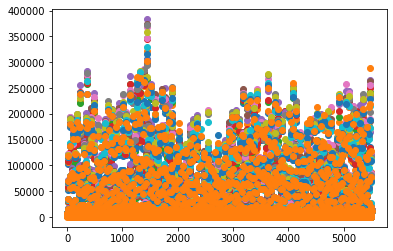

In [133]:
for year in range(2005,2017):
    plt.scatter(x=morbidity.index, y=morbidity[year]);

In [136]:
# Отыскиваем подозрительные точки
(morbidity[2005]>300000).loc[(morbidity[2005]>300000)==True]

1451    True
Name: 2005.0, dtype: bool

In [137]:
# Убеждаемся, что это не выбросы
morbidity.iloc[1451]

Region       Ненецкий автономный округ (Архангельская область)
Disease                                        Все заболевания
Age_group                                             0-14 лет
2005.0                                                306401.6
2006.0                                                322149.5
2007.0                                                346146.7
2008.0                                                345619.8
2009.0                                                383126.4
2010.0                                                373361.9
2011.0                                                368374.3
2012.0                                                372318.2
2013.0                                                358529.6
2014.0                                                328771.0
2015.0                                                316082.2
2016.0                                                301686.2
Name: 1451, dtype: object

Проверить на выбросы сложно, ведь данных очень много. Пропусков много только в Крыму и Севастополе, поэтому для конечной таблицы будем использовать среднее.

**Подготовка данных для final_df**

In [623]:
morbidity = morbidity.replace(rename_regions(morbidity['Region'].unique()))

In [624]:
regions = morbidity['Region'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [625]:
morbidity.to_csv('data/morbidity.csv')

## drug_alco

In [626]:
alco = pd.read_excel('data/social_russia_data/drug_alco.xlsx', sheet_name='alco')
alco1718 = pd.read_excel('data/social_russia_data/drug_alco.xlsx', sheet_name='alco1718')
drug = pd.read_excel('data/social_russia_data/drug_alco.xlsx', sheet_name='drugs')
drug1718 = pd.read_excel('data/social_russia_data/drug_alco.xlsx', sheet_name='drug1718')
child_mortality_coefficient = pd.read_csv('data/child_mortality_coefficient.csv', index_col='Unnamed: 0')

### Переименовываем регионы, как в final_df, чтобы объеденить таблицы

In [640]:
replace_dict = {
    'Архангельская область':'Архангельская область (кроме Ненецкого автономного округа)',
    'Кемеровская область':'Кемеровская область - Кузбасс',
    'Республика Адыгея (Адыгея) (до 03.06.2014)':'Республика Адыгея (Адыгея)',
    'Тюменская область':'Тюменская область (без автономных округов)',
    'г. Москва':'город Москва',
    'г. Санкт-Петербург':'город Санкт-Петербург'
}
replace_dict_1718 = {
    'Архангельская область без автономного округа':'Архангельская область (кроме Ненецкого автономного округа)',
    'Кемеровская область':'Кемеровская область - Кузбасс',
    'Ненецкий автономный округ':'Ненецкий автономный округ (Архангельская область)',
    'Республика Адыгея':'Республика Адыгея (Адыгея)',
    'Республика Северная Осетия - Алания':'Республика Северная Осетия-Алания',
    'Республика Татарстан':'Республика Татарстан (Татарстан)',
    'Тюменская область без автономного округа':'Тюменская область (без автономных округов)',
    'Ханты-Мансийский АО':'Ханты-Мансийский автономный округ - Югра (Тюменская область)',
    'Чувашская Республика':'Чувашская Республика - Чувашия',
    'Ямало-Hенецкий АО':'Ямало-Ненецкий автономный округ (Тюменская область)',
    'город Санкт - Петербург':'город Санкт-Петербург'
}

In [641]:
alco = alco.replace(replace_dict)
drug = drug.replace(replace_dict)
alco1718 = alco1718.replace(replace_dict_1718)
drug1718 = drug1718.replace(replace_dict_1718)

In [630]:
# Удаляем федеральные округи 
mask = []
for i in alco.index:
    mask.append(not ('федеральный округ' in alco['region'].loc[i]))
alco = alco.loc[mask].reset_index(drop=True)

In [631]:
# Удаляем федеральные округи 
mask = []
for i in alco1718.index:
    mask.append(not ('федеральный округ' in alco1718['region'].loc[i]))
alco1718 = alco1718.loc[mask].reset_index(drop=True)

In [632]:
# Удаляем федеральные округи 
mask = []
for i in drug.index:
    mask.append(not ('федеральный округ' in drug['region'].loc[i]))
drug = drug.loc[mask].reset_index(drop=True)

In [633]:
# Удаляем федеральные округи 
mask = []
for i in drug1718.index:
    mask.append(not ('федеральный округ' in drug1718['region'].loc[i]))
drug1718 = drug1718.loc[mask].reset_index(drop=True)

In [634]:
# Удаляем 'Главное медицинское управление Управления делами Президента Российской Федерации'
alco1718 = alco1718.drop(
    alco1718[alco1718['region']=='Главное медицинское управление Управления делами Президента Российской Федерации'].index
    ).reset_index(drop=True)
drug1718 = drug1718.drop(
    drug1718[drug1718['region']=='Главное медицинское управление Управления делами Президента Российской Федерации'].index
    ).reset_index(drop=True)

In [642]:
regions = alco1718['region'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [643]:
set(alco1718['region']) - set(alco['region'])

{'Республика Крым', 'город Севастополь'}

In [644]:
alco['region'].shape

(84,)

In [645]:
# Соединяем таблицы за разные года (У Крыма и Севастополя появятся пропуски)
alco = pd.merge(alco, alco1718, on='region', how='right')
drug = pd.merge(drug, drug1718, on='region', how='right')

### Работа с пропусками

In [646]:
# Транспонируем таблицу
df_step = alco.T
df_step.columns = df_step.loc['region']
df_step = df_step.drop('region')
alco = df_step
alco.index = [pd.Timestamp(year=x,month=1,day=1) for x in alco.index]

In [647]:
# Переводим столбцы в числовой формат, чтобы потом интерполировать
alco = alco.astype(float)
alco = alco.interpolate()

In [648]:
# Всё то же самое проводим с drug
# Транспонируем таблицу
df_step = drug.T
df_step.columns = df_step.loc['region']
df_step = df_step.drop('region')
drug = df_step
drug.index = [pd.Timestamp(year=x,month=1,day=1) for x in drug.index]
# Переводим столбцы в числовой формат, чтобы потом интерполировать
drug = drug.astype(float)
drug = drug.interpolate()

In [649]:
# Пропуски есть только в Крыму и Севастополе
alco.isna().sum().loc[alco.isna().sum()!=0]

region
Республика Крым      12
город Севастополь    12
dtype: int64

In [650]:
drug.isna().sum().loc[drug.isna().sum()!=0]

region
Республика Крым      12
город Севастополь    12
dtype: int64

In [651]:
# Проверяем на замаскированные под 0 пропуски alco
(alco==0).sum().loc[(alco==0).sum()!=0]

region
Республика Ингушетия    2
Чеченская Республика    1
dtype: int64

In [652]:
# 0 в Чеченской республике скорее всего пропуск, заполняем вручную близким значением исходя из колебаний в данных
display(alco['Чеченская Республика'])
alco.loc['2005-01-01','Чеченская Республика'] = 21

2005-01-01     0.000
2006-01-01    25.100
2007-01-01    39.300
2008-01-01    40.000
2009-01-01    20.200
2010-01-01    14.200
2011-01-01    12.800
2012-01-01     9.800
2013-01-01    13.100
2014-01-01    10.575
2015-01-01     8.050
2016-01-01     5.525
2017-01-01     3.000
2018-01-01     4.100
Name: Чеченская Республика, dtype: float64

In [653]:
# 0 в Ингушетии похожи на правду, оставим, как есть
alco['Республика Ингушетия']

2005-01-01    2.7
2006-01-01    2.9
2007-01-01    0.0
2008-01-01    0.6
2009-01-01    0.4
2010-01-01    0.4
2011-01-01    0.5
2012-01-01    0.7
2013-01-01    1.6
2014-01-01    1.2
2015-01-01    0.8
2016-01-01    0.4
2017-01-01    0.0
2018-01-01    0.2
Name: Республика Ингушетия, dtype: float64

In [654]:
# Проверяем на замаскированные под 0 пропуски drug
(drug==0).sum().loc[(drug==0).sum()!=0]

region
Ненецкий автономный округ (Архангельская область)    2
Республика Калмыкия                                  1
Чеченская Республика                                 1
Чукотский автономный округ                           6
dtype: int64

In [655]:
# Чеченскую республику заполним вручную
drug.loc['2005-01-01','Чеченская Республика'] = 11.3

In [656]:
# В остальных проведём интерполяцию
cols_with_0 = (drug==0).sum().loc[(drug==0).sum()!=0].index
drug[cols_with_0] = drug[cols_with_0].replace(0,np.NAN).interpolate()

### Проверка на выбросы

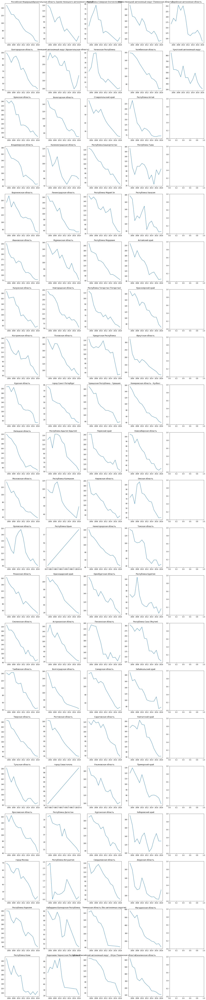

In [177]:
# Проверка alco
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(alco.columns):
    if i<21:
        axs[i,0].plot(alco[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(alco[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(alco[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(alco[col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(alco[col])
        axs[i-84,4].set_title(col)
plt.show()

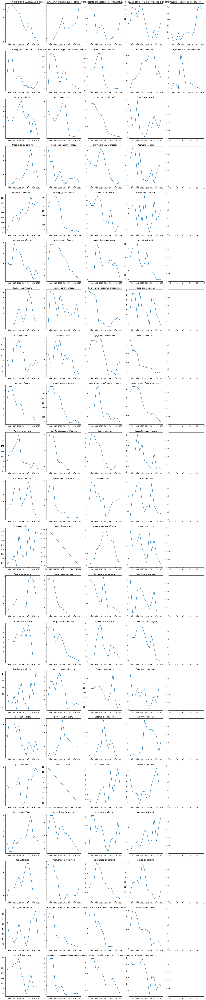

In [178]:
# Проверка drug
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(drug.columns):
    if i<21:
        axs[i,0].plot(drug[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(drug[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(drug[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(drug[col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(drug[col])
        axs[i-84,4].set_title(col)
plt.show()

In [657]:
# Выбросов вроде как нет
alco.to_csv('data/alco.csv')
drug.to_csv('data/drug.csv')

## poverty

In [658]:
poverty = pd.read_csv('data/social_russia_data/poverty_percent_by_regions_1992_2020.csv')
poverty

,region,year,poverty_percent
0,Российская Федерация,1992,33.5
1,Российская Федерация,1993,31.3
2,Российская Федерация,1994,22.4
3,Российская Федерация,1995,24.8
4,Российская Федерация,1996,22.1
...,...,...,...
2334,Чукотский автономный округ,2017,8.5
2335,Чукотский автономный округ,2018,8.8
2336,Чукотский автономный округ,2019,8.5
2337,Чукотский автономный округ,2020,8.0


In [659]:
# Удаляем федеральные округи 
mask = []
for i in poverty.index:
    mask.append(not ('федеральный округ' in poverty['region'].loc[i]))
poverty = poverty.loc[mask].reset_index(drop=True)

In [660]:
# Убираем отступы в названиях
poverty['region'] = poverty['region'].apply(lambda x: x.split('  ')[-1] if len(x.split('  '))>1 else x)

In [661]:
poverty = pd.pivot_table(data=poverty, index='year', columns='region', values='poverty_percent')
poverty.index = [pd.Timestamp(year=x, month=1, day=1) for x in poverty.index]
poverty

region,Алтайский край,Амурская область,Архангельская область,Архангельская область (кроме Ненецкого автономного округа),Астраханская область,Белгородская область,Брянская область,Владимирская область,Волгоградская область,Вологодская область,...,Удмуртская Республика,Ульяновская область,Хабаровский край,Ханты-Мансийский автономный округ - Югра (Тюменская область),Челябинская область,Чеченская Республика,Чувашская Республика - Чувашия,Чукотский автономный округ,Ямало-Ненецкий автономный округ (Тюменская область),Ярославская область
1992-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1993-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1994-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995-01-01,33.7,36.1,26.2,NaN,32.3,19.9,22.7,27.6,33.8,19.9,...,34.7,16.1,28.9,0.0,27.9,NaN,27.0,0.0,0.0,21.3
1996-01-01,46.8,28.2,26.8,NaN,30.7,17.6,19.2,26.7,28.6,21.1,...,26.6,15.2,24.3,0.0,27.2,NaN,27.0,0.0,0.0,20.4
1997-01-01,45.7,26.3,23.9,NaN,25.0,18.9,18.4,23.9,23.3,18.6,...,24.1,16.0,21.3,0.0,22.1,NaN,28.4,0.0,0.0,18.5
1998-01-01,52.9,31.2,31.6,NaN,30.4,20.1,25.3,27.7,31.2,22.7,...,31.0,17.3,21.7,0.0,26.9,NaN,43.0,0.0,0.0,22.5
1999-01-01,53.8,38.0,42.6,NaN,36.0,24.2,39.6,37.5,47.7,33.5,...,46.9,29.5,22.8,0.0,32.3,NaN,57.2,0.0,0.0,27.0
2000-01-01,53.9,47.7,33.5,NaN,33.4,33.6,42.3,44.7,34.9,25.5,...,35.1,44.5,35.5,11.8,30.7,NaN,51.3,50.1,11.1,30.7
2001-01-01,47.3,45.3,27.4,NaN,31.1,29.1,35.8,40.7,29.3,23.1,...,33.3,45.2,32.1,9.3,34.3,NaN,44.8,32.8,9.3,26.8


In [662]:
# Удаляем первые три пустые строчки
poverty = poverty.drop(poverty.iloc[:3].index)

In [663]:
# Замаскированные под 0 пропуски, заменяем их на np.NaN
poverty[(poverty==0).sum().loc[(poverty==0).sum()!=0].index]

region,Еврейская автономная область,Камчатский край,Ненецкий автономный округ (Архангельская область),Ханты-Мансийский автономный округ - Югра (Тюменская область),Чеченская Республика,Чукотский автономный округ,Ямало-Ненецкий автономный округ (Тюменская область)
1995-01-01,0.0,22.7,0.0,0.0,NaN,0.0,0.0
1996-01-01,0.0,27.8,0.0,0.0,NaN,0.0,0.0
1997-01-01,0.0,25.6,0.0,0.0,NaN,0.0,0.0
1998-01-01,0.0,30.9,0.0,0.0,NaN,0.0,0.0
1999-01-01,0.0,32.1,0.0,0.0,NaN,0.0,0.0
2000-01-01,57.3,0.0,37.9,11.8,NaN,50.1,11.1
2001-01-01,51.1,0.0,26.9,9.3,NaN,32.8,9.3
2002-01-01,38.4,34.3,21.5,11.6,NaN,28.6,7.7
2003-01-01,32.8,26.6,8.3,10.6,0.0,19.2,8.0
2004-01-01,29.8,23.1,8.2,10.0,0.0,20.1,7.1


In [664]:
poverty = poverty.replace(0, np.NAN)

In [665]:
# Посмотрим, где есть пропуски
many_nans = poverty.isna().sum().loc[poverty.isna().sum()>0]
many_nans

region
Архангельская область (кроме Ненецкого автономного округа)                                                  17
Город федерального значения Севастополь                                                                     20
Еврейская автономная область                                                                                 5
Камчатский край                                                                                              2
Ненецкий автономный округ (Архангельская область)                                                            5
Республика Крым                                                                                             20
Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)    17
Ханты-Мансийский автономный округ - Югра (Тюменская область)                                                 5
Чеченская Республика                                                                                     

In [666]:
# Применяем интерполяцию на Камчатский край, там пропуски по середине
poverty['Камчатский край'] = poverty['Камчатский край'].interpolate()

In [667]:
# У остальных пропуски идут с начала, они не помешают нашей функции для предсказания
many_nans = poverty.isna().sum().loc[poverty.isna().sum()>0]
poverty[many_nans.index]

region,Архангельская область (кроме Ненецкого автономного округа),Город федерального значения Севастополь,Еврейская автономная область,Ненецкий автономный округ (Архангельская область),Республика Крым,Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа),Ханты-Мансийский автономный округ - Югра (Тюменская область),Чеченская Республика,Чукотский автономный округ,Ямало-Ненецкий автономный округ (Тюменская область)
1995-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-01-01,NaN,NaN,57.3,37.9,NaN,NaN,11.8,NaN,50.1,11.1
2001-01-01,NaN,NaN,51.1,26.9,NaN,NaN,9.3,NaN,32.8,9.3
2002-01-01,NaN,NaN,38.4,21.5,NaN,NaN,11.6,NaN,28.6,7.7
2003-01-01,NaN,NaN,32.8,8.3,NaN,NaN,10.6,NaN,19.2,8.0
2004-01-01,NaN,NaN,29.8,8.2,NaN,NaN,10.0,NaN,20.1,7.1


### Проверка на выбросы

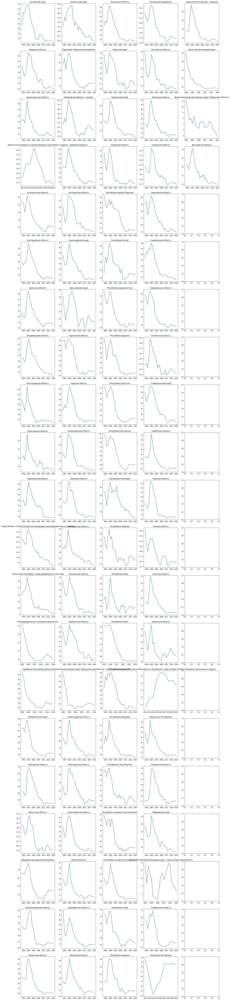

In [191]:
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(poverty.columns):
    if i<21:
        axs[i,0].plot(poverty[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(poverty[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(poverty[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(poverty[col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(poverty[col])
        axs[i-84,4].set_title(col)
plt.show()

### Переименновываем столбцы

In [668]:
# Удаляем 'Архангельская область' и 'Тюменская область', будем пользоваться ими без автономных округов
poverty = poverty.drop(['Архангельская область','Тюменская область'], axis=1)
# Остальные переименновываем, как обычно
poverty = poverty.rename(columns=rename_regions(poverty.columns))

In [669]:
regions = poverty.columns
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [670]:
poverty.to_csv('data/poverty.csv')

## poverty_socdem

In [671]:
poverty_socdem_2017 = pd.read_excel('data/social_russia_data/poverty_socdem_2017.xls')
poverty_socdem_2018 = pd.read_excel('data/social_russia_data/poverty_socdem_2018.xls')
poverty_socdem_2019 = pd.read_excel('data/social_russia_data/poverty_socdem_2019.xls')
poverty_socdem_2020 = pd.read_excel('data/social_russia_data/poverty_socdem_2020.xls')

In [672]:
poverty_socdem_2017

,"Распределение малоимущего населения по социально-демографическим группам (2017, процент, значение показателя за год)",Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4
0,NaN,NaN,NaN,NaN,NaN
1,NaN,Все население,Дети в возрасте до 16 лет,Население старше трудоспособного возраста,Население трудоспособного возраста
2,Российская Федерация,100,39.3,6.6,54.1
3,Белгородская область,100,43.4,11.8,44.8
4,Брянская область,100,42.9,4.9,52.2
...,...,...,...,...,...
85,Амурская область,100,39.9,6,54.1
86,Магаданская область,100,32.2,14.8,53
87,Сахалинская область,100,36.4,6.4,57.1
88,Еврейская автономная область,100,36,9.9,54.1


In [673]:
dfs = [poverty_socdem_2017, poverty_socdem_2018, poverty_socdem_2019, poverty_socdem_2020]
# Приводим в порядок таблицы
for i in range(len(dfs)):
    # Приводим в порядок названия столбцов и удаляем ненужные строчки
    cols = dfs[i].loc[1]
    cols[0] = 'Region'
    dfs[i].columns = cols
    dfs[i] = dfs[i].drop('Все население', axis=1)
    dfs[i] = dfs[i].drop([0,1]).reset_index(drop=True)
    # Убираем отступы в названиях регионов
    dfs[i]['Region'] = dfs[i]['Region'].apply(lambda x: x.split('  ')[-1])

### Переименновываем регионы

In [674]:
child_mortality_coefficient = pd.read_csv('data/child_mortality_coefficient.csv', index_col='Unnamed: 0')

In [675]:
set(child_mortality_coefficient) - set(dfs[0]['Region'])

{'Архангельская область (кроме Ненецкого автономного округа)',
 'Тюменская область (без автономных округов)',
 'город Москва',
 'город Санкт-Петербург',
 'город Севастополь'}

In [676]:
set(dfs[0]['Region']) - set(child_mortality_coefficient)

{'Архангельская область',
 'Архангельская область (без АО)',
 'Город Москва столица Российской Федерации город федерального значения',
 'Город Санкт-Петербург город федерального значения',
 'Город федерального значения Севастополь',
 'Тюменская область',
 'Тюменская область (без АО)'}

In [677]:
# Переименновываем регионы и удаляем Тюменскую и Архангельскую области
for i in range(len(dfs)):
    dfs[i] = dfs[i].drop(
        dfs[i][(dfs[i]['Region']=='Архангельская область')|(dfs[i]['Region']=='Тюменская область')].index
        ).reset_index(drop=True)
    
    dfs[i] = dfs[i].replace({
        'Архангельская область (без АО)':'Архангельская область (кроме Ненецкого автономного округа)',
        'Тюменская область (без АО)':'Тюменская область (без автономных округов)',
        'Город Москва столица Российской Федерации город федерального значения':'город Москва',
        'Город Санкт-Петербург город федерального значения':'город Санкт-Петербург',
        'Город федерального значения Севастополь':'город Севастополь'
    })


### Смотрим пропуски

In [678]:
# Есть пропуски в третьей таблице
df = dfs[3]
df[df['Region']=='Ленинградская область']

1,Region,Дети в возрасте до 16 лет,Население старше трудоспособного возраста,Население трудоспособного возраста
25,Ленинградская область,NaN,NaN,NaN


In [679]:
dfs[0].isna().sum()

1
Region                                       0
Дети в возрасте до 16 лет                    0
Население старше трудоспособного возраста    0
Население трудоспособного возраста           0
dtype: int64

In [680]:
# Есть замаскированные под 0 пропуски во второй таблице, заменим их на пропуски
(dfs[2]==0).sum(axis=1).loc[(dfs[2]==0).sum(axis=1)==3]

1     3
25    3
29    3
31    3
85    3
dtype: int64

In [681]:
dfs[3].isna().sum(axis=1).loc[dfs[3].isna().sum(axis=1)!=0]

1     3
3     3
5     3
6     3
21    3
25    3
29    3
37    3
47    3
82    3
83    3
85    3
dtype: int64

In [682]:
(dfs[1]==0).sum()

1
Region                                       0
Дети в возрасте до 16 лет                    0
Население старше трудоспособного возраста    1
Население трудоспособного возраста           0
dtype: int64

### Считаем среднее (для предсказания маловато данных, всего 4 года)

In [683]:
# Видно, что в таблицах за 2019 и 2020 года есть пропуски, а в первых двух нет.
# Пока что в final_df запишу средние значения первых двух.
df = pd.DataFrame()
df['Region'] = dfs[0]['Region']
df['Дети в возрасте до 16 лет'] = (dfs[0]['Дети в возрасте до 16 лет']+
                                   dfs[1]['Дети в возрасте до 16 лет'])/2
df['Население старше трудоспособного возраста'] = (dfs[0]['Население старше трудоспособного возраста']+
                                                   dfs[1]['Население старше трудоспособного возраста'])/2
# Не включаю 'Население трудоспособного возраста', т.к. это линейная комбинация первых двух столбцов с данными

In [684]:
# Перевожу регионы в индексы
df.index = df['Region'].values
df = df.drop('Region', axis=1)

### Проверка на выбросы

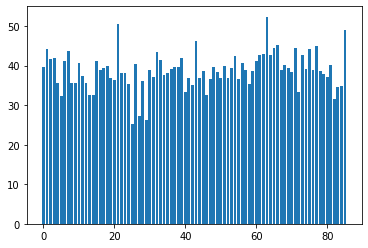

In [219]:
plt.bar(x=range(len(df)), height=df['Дети в возрасте до 16 лет']);

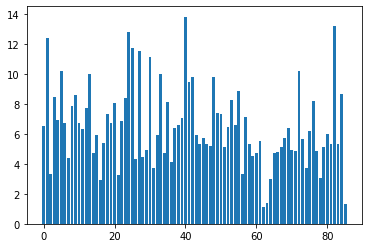

In [221]:
plt.bar(x=range(len(df)), height=df['Население старше трудоспособного возраста']);

In [685]:
# Аномальных значений нет
df.to_csv('data/poverty_socdem.csv')

## welfare_expense

In [686]:
welfare_expense = pd.read_excel('data/social_russia_data/welfare_expense_share_2015_2020.xlsx')
welfare_expense

,region,2015,2016,2017,2018,2019,2020
0,Российская Федерация,15.8,16.6,20.4,20.3,19.8,21.3
1,Центральный\n федеральный округ,NaN,NaN,NaN,NaN,NaN,NaN
2,Белгородская область,11.3,11.8,16.4,15.6,13.8,16.1
3,Брянская область,22.0,26.6,24.7,23.7,20.7,23.1
4,Владимирская область,18.1,18.0,24.0,23.4,23.4,26.0
...,...,...,...,...,...,...,...
89,Амурская область,19.2,28.9,26.3,24.1,22.7,21.7
90,Магаданская область,9.8,10.6,13.4,12.8,12.3,11.1
91,Сахалинская область,6.4,9.9,16.8,14.3,13.8,16.5
92,Еврейская автономная область,18.4,17.7,28.3,27.8,25.7,31.2


In [687]:
# Удаляем федеральные округи
mask = []
for i in welfare_expense.index:
    mask.append(not ('федеральный округ' in welfare_expense['region'].loc[i]))
welfare_expense = welfare_expense.loc[mask].reset_index(drop=True)

### Переименновываем регионы

In [688]:
welfare_expense = welfare_expense.replace(rename_regions(welfare_expense['region'].unique()))

In [689]:
regions = welfare_expense['region'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [690]:
# Транспонируем таблицу
df = welfare_expense.T
df.columns = df.loc['region'].values
df = df.drop('region', axis=0)
welfare_expense = df

### Проверка на пропуски и выбросы

In [691]:
# пропусков нет
welfare_expense.isna().sum().sum()

0

In [692]:
# Замаскированных под 0 тоже нет
(welfare_expense==0).sum().sum()

0

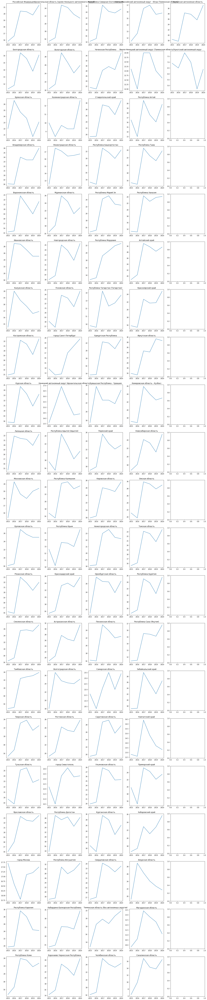

In [233]:
# Проверка на выбросы
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(welfare_expense.columns):
    if i<21:
        axs[i,0].plot(welfare_expense[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(welfare_expense[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(welfare_expense[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(welfare_expense[col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(welfare_expense[col])
        axs[i-84,4].set_title(col)
plt.show()

In [693]:
# Выбросов нет
welfare_expense.to_csv('data/welfare_expense.csv')

## wages

In [694]:
dfs = []
dfs.append(pd.read_excel('data/social_russia_data/cash_real_income_wages_2015_2020.xlsx', sheet_name='per_capita_cash_income'))
dfs.append(pd.read_excel('data/social_russia_data/cash_real_income_wages_2015_2020.xlsx', sheet_name='real_incomes'))
dfs.append(pd.read_excel('data/social_russia_data/cash_real_income_wages_2015_2020.xlsx', sheet_name='formal_wage_paid'))
dfs.append(pd.read_excel('data/social_russia_data/cash_real_income_wages_2015_2020.xlsx', sheet_name='real_pay'))

In [695]:
# Удаляем федеральные округи
for j in range(len(dfs)):
    mask = []
    for i in dfs[j].index:
        mask.append(not ('федеральный округ' in dfs[j]['region'].loc[i]))
    dfs[j] = dfs[j].loc[mask].reset_index(drop=True)

### Работа с пропусками

In [696]:
# Удаляем пустые строчки и пропусков больше не останется (Только по одному в Крыму и Севастополе в начале, их оставим)
for j in range(len(dfs)):
    dfs[j] = dfs[j].dropna(axis=0, thresh=6)

In [697]:
# В третьей таблице есть замаскированные под троеточия пропуски
dfs[3] = dfs[3].replace('…', np.NAN)

In [698]:
# Удаляем Архангельскую и Тюменскую области (оставляем их без АО)
for j in range(len(dfs)):
    dfs[j] = dfs[j].drop(
        dfs[j][(dfs[j]['region']=='Архангельская область')|(dfs[j]['region']=='Тюменская область')].index
    ).reset_index(drop=True)

### Переименновываем регионы

In [699]:
replace_dict = rename_regions(dfs[0]['region'].unique())

In [700]:
for j in range(len(dfs)):
    dfs[j] = dfs[j].replace(replace_dict)

In [701]:
regions = dfs[1]['region'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [702]:
# Транспонируем таблицы
for j in range(len(dfs)):
    df = dfs[j].T
    df.columns = df.loc['region'].values
    df = df.drop('region', axis=0)
    dfs[j] = df

### Проверка на выбросы

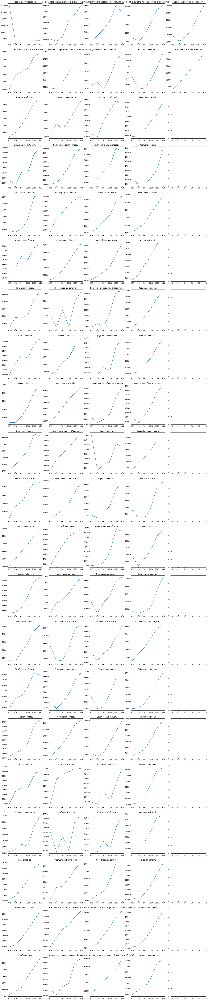

In [247]:
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(dfs[0].columns):
    if i<21:
        axs[i,0].plot(dfs[0][col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(dfs[0][col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(dfs[0][col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(dfs[0][col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(dfs[0][col])
        axs[i-84,4].set_title(col)
plt.show()

In [703]:
# Заметил явную ошибку в первой таблице (исправим её поделив значение на 10)
dfs[0].loc[2015,'Российская Федерация'] = dfs[0].loc[2015,'Российская Федерация']/10

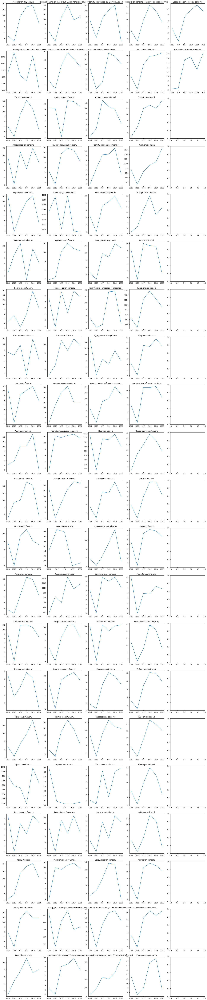

In [249]:
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(dfs[1].columns):
    if i<21:
        axs[i,0].plot(dfs[1][col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(dfs[1][col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(dfs[1][col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(dfs[1][col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(dfs[1][col])
        axs[i-84,4].set_title(col)
plt.show()

In [704]:
# Подозрительные значения есть, заменим их вручную
display(dfs[1][['город Севастополь','Пермский край']])
dfs[1].loc[2016,['город Севастополь','Пермский край']] = [105, 95]

,город Севастополь,Пермский край
2015,NaN,101.3
2016,139.3,81.6
2017,104.1,99.2
2018,101.4,98.8
2019,101.2,101.9
2020,102.9,95.1


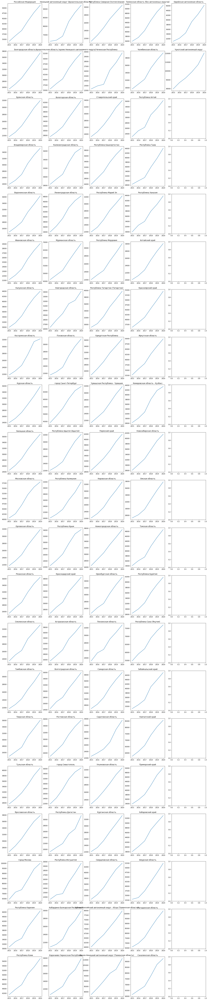

In [255]:
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(dfs[2].columns):
    if i<21:
        axs[i,0].plot(dfs[2][col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(dfs[2][col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(dfs[2][col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(dfs[2][col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(dfs[2][col])
        axs[i-84,4].set_title(col)
plt.show()

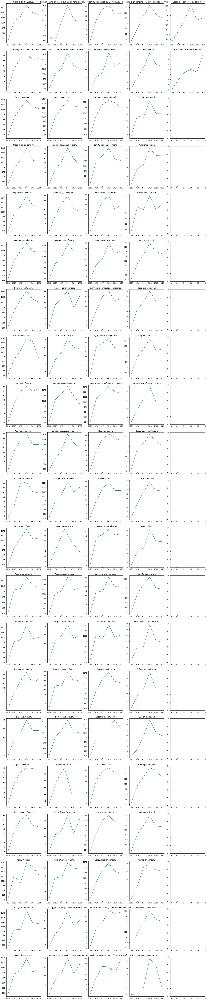

In [256]:
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(dfs[3].columns):
    if i<21:
        axs[i,0].plot(dfs[3][col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(dfs[3][col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(dfs[3][col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(dfs[3][col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(dfs[3][col])
        axs[i-84,4].set_title(col)
plt.show()

In [705]:
# Выбросов больше нет
dfs[0].to_csv('data/per_capita_cash_income.csv')
dfs[1].to_csv('data/real_incomes.csv')
dfs[2].to_csv('data/formal_wage_paid.csv')
dfs[3].to_csv('data/real_pay.csv')

## housing

In [706]:
housing_cond = pd.read_excel('data/social_russia_data/housing_2020.xlsx', sheet_name='housing_cond')
housing_intent = pd.read_excel('data/social_russia_data/housing_2020.xlsx', sheet_name='housing_intent')

In [707]:
# Убираем последние ненужные строчки
housing_intent = housing_intent.drop([94,95]).reset_index(drop=True)

In [708]:
# Удаляем федеральные округи
mask = []
for i in housing_intent.index:
    mask.append(not ('федеральный округ' in housing_intent['Регион'].loc[i]))
housing_intent = housing_intent.loc[mask].reset_index(drop=True)

In [709]:
# Удаляем федеральные округи
mask = []
for i in housing_cond.index:
    mask.append(not ('федеральный округ' in housing_cond['Регион'].loc[i]))
housing_cond = housing_cond.loc[mask].reset_index(drop=True)

In [710]:
# Убираем ненужные столбцы
housing_cond = housing_cond.drop(['Число домохозяйств, проживающих во всех типах жилых помещений','затруднились ответить'], axis=1)
housing_intent = housing_intent.drop('Все домохозяйства', axis=1)

In [711]:
# Удаляем столбцы, где много пропусков-многоточий, т.к. непонятно как заполнять
housing_intent = housing_intent.iloc[:,[0,1,2,3,4,-1]]

### Переименновываем регионы

In [264]:
child_mortality_coefficient = pd.read_csv('data/child_mortality_coefficient.csv',index_col='Unnamed: 0')

In [265]:
set(housing_cond['Регион']) - set(child_mortality_coefficient.columns)

{'Bладимирская область',
 'Bолгоградская область',
 'Bологодская область',
 'Bоронежская область',
 'Архангельская область без авт. округа',
 'Еврейская авт. область',
 'Кемеровская область',
 'Ненецкий авт. округ',
 'Республика Адыгея',
 'Республика Саха(Якутия)',
 'Республика Татарстан',
 'Тюменская область без авт. округов',
 'Ханты-Мансийский авт. округ',
 'Чувашская Республика',
 'Чукотский авт. округ',
 'Ямало-Ненецкий авт. округ',
 'г. Санкт-Петербург',
 'г. Севастополь',
 'г.Москва'}

In [266]:
set(child_mortality_coefficient.columns) - set(housing_cond['Регион'])

{'Архангельская область (кроме Ненецкого автономного округа)',
 'Владимирская область',
 'Волгоградская область',
 'Вологодская область',
 'Воронежская область',
 'Еврейская автономная область',
 'Кемеровская область - Кузбасс',
 'Ненецкий автономный округ (Архангельская область)',
 'Республика Адыгея (Адыгея)',
 'Республика Саха (Якутия)',
 'Республика Татарстан (Татарстан)',
 'Тюменская область (без автономных округов)',
 'Ханты-Мансийский автономный округ - Югра (Тюменская область)',
 'Чувашская Республика - Чувашия',
 'Чукотский автономный округ',
 'Ямало-Ненецкий автономный округ (Тюменская область)',
 'город Москва',
 'город Санкт-Петербург',
 'город Севастополь'}

In [717]:
replace_dict = {
 'Bладимирская область':'Владимирская область',
 'Bолгоградская область':'Волгоградская область',
 'Bологодская область':'Вологодская область',
 'Bоронежская область':'Воронежская область',
 'Архангельская область без авт. округа':'Архангельская область (кроме Ненецкого автономного округа)',
 'Еврейская авт. область':'Еврейская автономная область',
 'Кемеровская область':'Кемеровская область - Кузбасс',
 'Ненецкий авт. округ':'Ненецкий автономный округ (Архангельская область)',
 'Республика Адыгея':'Республика Адыгея (Адыгея)',
 'Республика Саха(Якутия)':'Республика Саха (Якутия)',
 'Республика Татарстан':'Республика Татарстан (Татарстан)',
 'Тюменская область без авт. округов':'Тюменская область (без автономных округов)',
 'Ханты-Мансийский авт. округ':'Ханты-Мансийский автономный округ - Югра (Тюменская область)',
 'Чувашская Республика':'Чувашская Республика - Чувашия',
 'Чукотский авт. округ':'Чукотский автономный округ',
 'Ямало-Ненецкий авт. округ':'Ямало-Ненецкий автономный округ (Тюменская область)',
 'г. Санкт-Петербург':'город Санкт-Петербург',
 'г. Севастополь':'город Севастополь',
 'г.Москва':'город Москва'
}

In [718]:
housing_cond = housing_cond.replace(replace_dict)
housing_intent = housing_intent.replace(replace_dict)

In [719]:
regions = housing_cond['Регион'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [720]:
set(housing_intent['Регион']) - set(housing_cond['Регион'])

set()

In [721]:
housing_cond.index = housing_cond['Регион']
housing_cond = housing_cond.drop('Регион', axis=1)

In [722]:
housing_intent.index = housing_intent['Регион']
housing_intent = housing_intent.drop('Регион', axis=1)

### Проверка на пропуски и выбросы

пропусков нет

In [723]:
housing_cond.isna().sum().sum()

0

In [724]:
housing_intent.isna().sum().sum()

0

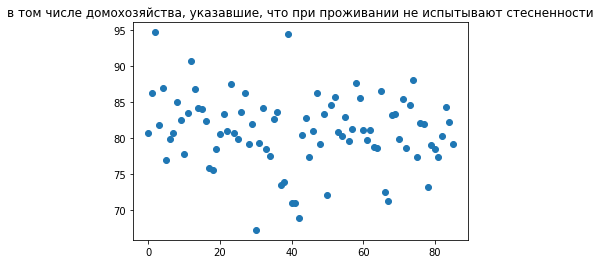

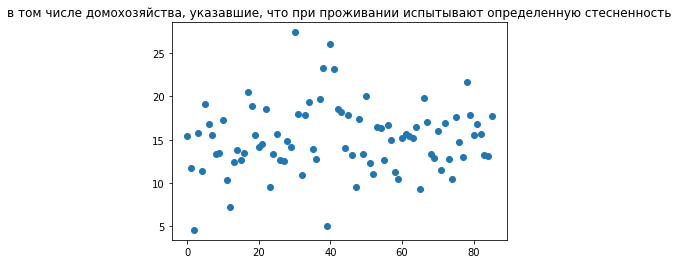

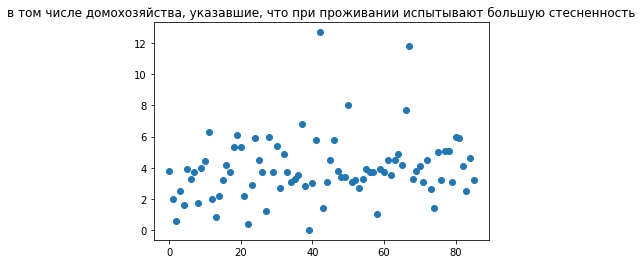

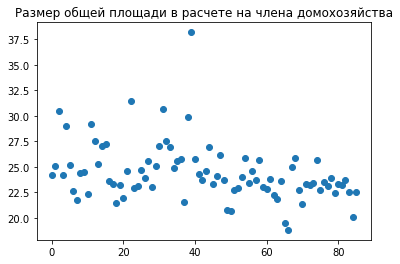

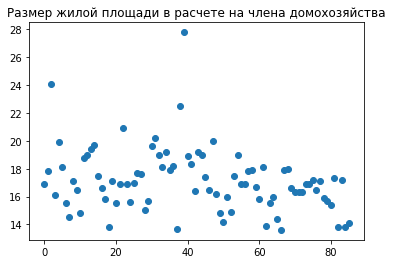

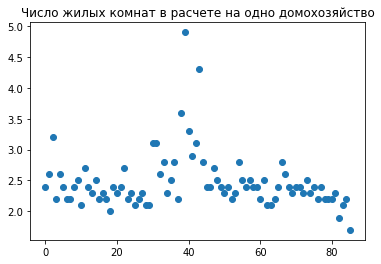

In [282]:
for col in housing_cond.columns:
    fig, ax = plt.subplots()
    ax.scatter(x=range(len(housing_cond)),y=housing_cond[col])
    ax.set_title(col)
    plt.show()

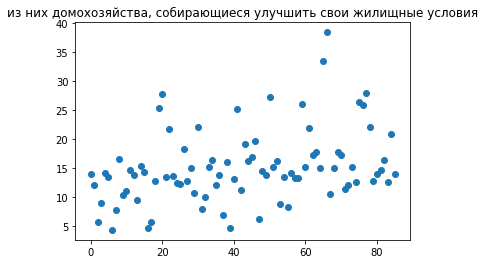

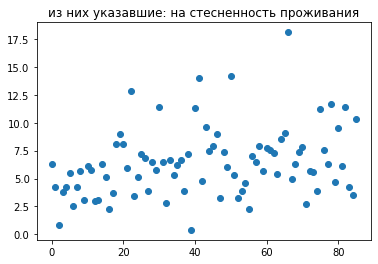

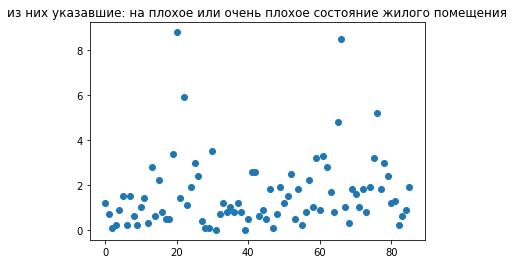

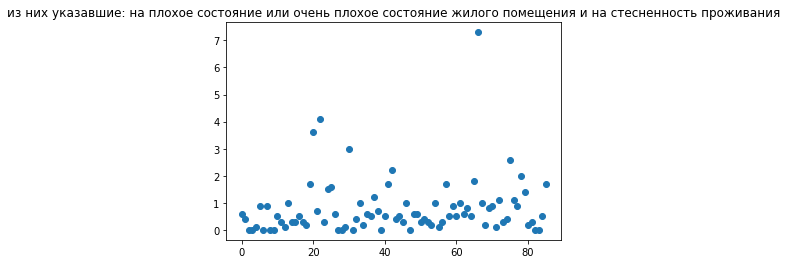

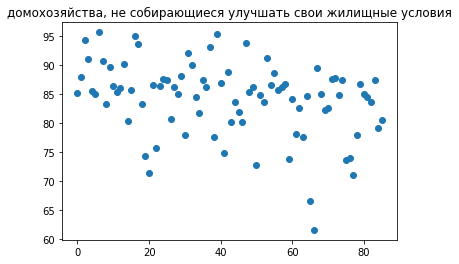

In [284]:
for col in housing_intent.columns:
    fig, ax = plt.subplots()
    ax.scatter(x=range(len(housing_intent)),y=housing_intent[col])
    ax.set_title(col)
    plt.show()

Аномальных значений тоже нет

In [725]:
housing_cond.to_csv('data/housing_cond.csv')
housing_intent.to_csv('data/housing_intent.csv')

## gross_regional_product

In [726]:
grp = pd.read_excel('data/social_russia_data/gross_regional_product_1996_2020.xls')

In [727]:
# Приводим в порядок названия столбцов
cols = list(grp.iloc[1])
cols[0] = 'region'
grp.columns = cols
grp = grp.drop([0,1]).reset_index(drop=True)

In [728]:
# Удаляем федеральные округи
mask = []
for i in grp.index:
    mask.append(not ('федеральный округ' in grp['region'].loc[i]))
grp = grp.loc[mask].reset_index(drop=True)

In [729]:
# Убираем отступы в названиях регионов
grp['region'] = grp['region'].apply(lambda x: x.split('  ')[-1])

In [730]:
# Оставляем Архангельскую и Тюменскую области только без АО
grp = grp.drop(
    grp[(grp['region']=='Архангельская область')|(grp['region']=='Тюменская область')].index
    ).reset_index(drop=True)

### Переименновываем регионы

In [732]:
grp = grp.replace(rename_regions(grp['region'].unique()))

In [733]:
regions = grp['region'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [734]:
# Заменяем 0 на пропуски
grp = grp.replace(0,np.NAN)

In [735]:
# У всех регионов пропуски только в начале, они не помешают предсказанию
grp.loc[grp.isna().sum(axis=1).loc[grp.isna().sum(axis=1)!=0].index]

,region,1996.0,1997.0,1998.0,1999.0,2000.0,2001.0,2002.0,2003.0,2004.0,...,2011.0,2012.0,2013.0,2014.0,2015.0,2016.0,2017.0,2018.0,2019.0,2020.0
21,Ненецкий автономный округ (Архангельская область),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3913588.7,3685897.1,4035943.2,4329031.1,5210143.9,5964557.0,6045235.6,7296374.4,7530484.7,5206287.1
22,Архангельская область (кроме Ненецкого автоном...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,232540.7,270662.9,283264.5,310817.4,352837.9,400764.6,441961.6,493205.1,509917.0,514200.4
32,Республика Крым,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,100526.4,139873.3,189916.6,201251.2,228692.9,245411.7,270363.8
37,город Севастополь,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,78009.3,119384.5,211366.0,234060.8,276550.7,306891.7,295304.9
43,Чеченская Республика,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,67220.5,77877.2,91646.1,109649.0,111705.4,143561.5,151464.0,154705.5,164617.3,171029.5
61,Ханты-Мансийский автономный округ - Югра (Тюме...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1575300.0,1719109.2,1715722.4,1782617.7,1947653.2,1912836.6,2155227.7,2715827.8,2733622.7,1994630.3
62,Ямало-Ненецкий автономный округ (Тюменская обл...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1820301.3,2209803.4,2544898.0,3025745.6,3336453.4,3790547.2,4571566.9,5650999.3,5710467.4,5072483.6
63,Тюменская область (без автономных округов),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,522064.8,532020.4,604921.2,564680.5,628098.5,659860.8,727930.9,872684.2,821610.6,757076.0


In [736]:
# Транспонируем таблицу
df = grp.T
df.columns = df.loc['region'].values
df = df.drop('region', axis=0)
grp = df

### Проверка на выбросы

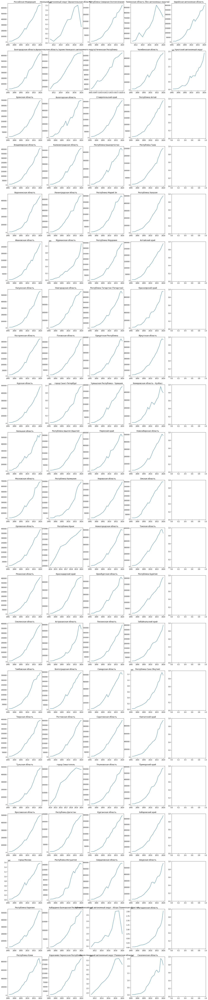

In [299]:
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(grp.columns):
    if i<21:
        axs[i,0].plot(grp[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(grp[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(grp[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(grp[col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(grp[col])
        axs[i-84,4].set_title(col)
plt.show()

In [737]:
# Выбросов вроде нету
grp.to_csv('data/grp.csv')

## regional_production

In [738]:
regional_production_2005_2016 = pd.read_csv('data/social_russia_data/regional_production_2005_2016.csv')
regional_production_2017_2020 = pd.read_csv('data/social_russia_data/regional_production_2017_2020.csv')

In [739]:
mask = []
for production_field in regional_production_2017_2020['production_field']:
    mask.append(production_field[0]!=' ')
regional_production_2017_2020[mask]['production_field'].value_counts()

production_field
ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА                                                                                     96
ОБЕСПЕЧЕНИЕ ЭЛЕКТРИЧЕСКОЙ ЭНЕРГИЕЙ, ГАЗОМ И ПАРОМ; КОНДИЦИОНИРОВАНИЕ ВОЗДУХА                                    96
Промышленное производство (промышленность)                                                                      96
ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ                                                                                      94
ВОДОСНАБЖЕНИЕ; ВОДООТВЕДЕНИЕ, ОРГАНИЗАЦИЯ СБОРА И УТИЛИЗАЦИИ ОТХОДОВ, ДЕЯТЕЛЬНОСТЬ ПО ЛИКВИДАЦИИ ЗАГРЯЗНЕНИЙ    94
Производство готовых металлических изделий, не включенных в другие группировки                                   1
Производство прочих транспортных средств, не включенных в другие группировки                                     1
Name: count, dtype: int64

In [741]:
regional_production_2005_2016['production_field'].value_counts()

production_field
РАЗДЕЛ E ПРОИЗВОДСТВО И РАСПРЕДЕЛЕНИЕ ЭЛЕКТРОЭНЕРГИИ, ГАЗА И ВОДЫ                                                                                      109
РАЗДЕЛ D ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА                                                                                                                   109
РАЗДЕЛ С ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ                                                                                                                    108
    Подраздел DM ПРОИЗВОДСТВО ТРАНСПОРТНЫХ СРЕДСТВ И  ОБОРУДОВАНИЯ                                                                                      12
    Подраздел СА ДОБЫЧА ТОПЛИВНО-ЭНЕРГЕТИЧЕСКИХ ПОЛЕЗНЫХ  ИСКОПАЕМЫХ                                                                                    12
    Подраздел DJ МЕТАЛЛУРГИЧЕСКОЕ ПРОИЗВОДСТВО И  ПРОИЗВОДСТВО ГОТОВЫХ МЕТАЛЛИЧЕСКИХ ИЗДЕЛИЙ                                                            12
        Металлургическое производство                

In [740]:
mask = []
for production_field in regional_production_2005_2016['production_field']:
    mask.append(production_field[0]!=' ')
regional_production_2005_2016[mask]['production_field'].value_counts()

production_field
РАЗДЕЛ D ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА                                                                                 109
РАЗДЕЛ E ПРОИЗВОДСТВО И РАСПРЕДЕЛЕНИЕ ЭЛЕКТРОЭНЕРГИИ, ГАЗА И ВОДЫ                                                    109
РАЗДЕЛ С ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ                                                                                  108
Производство кокса и нефтепродуктов                                                                                   12
Производство машин и оборудования (без производства оружия и боеприпасов)                                             12
Производство, передача и распределение электроэнергии, газа, пара и горячей воды                                      12
Сбор, очистка и распределение воды                                                                                    12
Добыча и обогащение прочих полезных ископаемых, не включенных в другие группировки                                    10
Добыча полезных

### Отделим 3 основных раздела и будем работать с ними

In [742]:
# Отделяем таблицы с выбранными разделами
production_2005_2016 = regional_production_2005_2016[
    (regional_production_2005_2016['production_field']=='РАЗДЕЛ С ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ')|
    (regional_production_2005_2016['production_field']=='РАЗДЕЛ D ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА')|
    (regional_production_2005_2016['production_field']=='РАЗДЕЛ E ПРОИЗВОДСТВО И РАСПРЕДЕЛЕНИЕ ЭЛЕКТРОЭНЕРГИИ, ГАЗА И ВОДЫ')
    ].reset_index(drop=True)

production_2017_2020 = regional_production_2017_2020[
    (regional_production_2017_2020['production_field']=='ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ')|
    (regional_production_2017_2020['production_field']=='ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА')|
    (regional_production_2017_2020['production_field']=='ОБЕСПЕЧЕНИЕ ЭЛЕКТРИЧЕСКОЙ ЭНЕРГИЕЙ, ГАЗОМ И ПАРОМ; КОНДИЦИОНИРОВАНИЕ ВОЗДУХА')
    ].reset_index(drop=True)

In [743]:
# Переименновываем разделы соответственно
production_2005_2016 = production_2005_2016.replace({
    'РАЗДЕЛ С ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ':'ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ',
    'РАЗДЕЛ D ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА':'ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА',
    'РАЗДЕЛ E ПРОИЗВОДСТВО И РАСПРЕДЕЛЕНИЕ ЭЛЕКТРОЭНЕРГИИ, ГАЗА И ВОДЫ':'ЭЛЕКТРОЭНЕРГИЯ И ГАЗ'
})
production_2017_2020 = production_2017_2020.replace({
    'ОБЕСПЕЧЕНИЕ ЭЛЕКТРИЧЕСКОЙ ЭНЕРГИЕЙ, ГАЗОМ И ПАРОМ; КОНДИЦИОНИРОВАНИЕ ВОЗДУХА':'ЭЛЕКТРОЭНЕРГИЯ И ГАЗ'
})

### Работа с регионами

In [744]:
# Удаляем федеральные округи
mask = []
for i in production_2005_2016.index:
    mask.append(not ('федеральный округ' in production_2005_2016['region'].loc[i]))
production_2005_2016 = production_2005_2016.loc[mask].reset_index(drop=True)

In [745]:
# Удаляем федеральные округи
mask = []
for i in production_2017_2020.index:
    mask.append(not ('федеральный округ' in production_2017_2020['region'].loc[i]))
production_2017_2020 = production_2017_2020.loc[mask].reset_index(drop=True)

In [746]:
# Убираем отступы в названиях регионов
production_2005_2016['region'] = production_2005_2016['region'].apply(lambda x: x.split('  ')[-1])

In [747]:
# Убираем отступы в названиях регионов
production_2017_2020['region'] = production_2017_2020['region'].apply(lambda x: x.split('  ')[-1])

### Переименновываем регионы

In [748]:
child_mortality_coefficient = pd.read_csv('data/child_mortality_coefficient.csv', index_col='Unnamed: 0')

In [749]:
# Заполняем пропуски в 'Архангельская область (кроме Ненецкого автономного округа)'
indexes = production_2005_2016[(production_2005_2016['region']=='Архангельская область (кроме Ненецкого автономного округа)')].index
cols = production_2005_2016.columns[2:]
for i in indexes:
    production_field = production_2005_2016.iloc[i]['production_field'] 
    i_1 = production_2005_2016[
                (production_2005_2016['region']=='Архангельская область')&(production_2005_2016['production_field']==production_field)
                ].index[0]
    i_2 = production_2005_2016[
                (production_2005_2016['region']=='Ненецкий автономный округ (Архангельская область)')&(production_2005_2016['production_field']==production_field)
                ].index[0]
    production_2005_2016.loc[i,cols] = production_2005_2016.loc[i_1,cols] - production_2005_2016.loc[i_2, cols]

In [750]:
# Заполняем пропуски в 'Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)'
indexes = production_2005_2016[(production_2005_2016['region']=='Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)')].index
cols = production_2005_2016.columns[2:]
for i in indexes:
    production_field = production_2005_2016.iloc[i]['production_field'] 
    i_1 = production_2005_2016[
                (production_2005_2016['region']=='Тюменская область')&(production_2005_2016['production_field']==production_field)
                ].index[0]
    i_2 = production_2005_2016[
                (production_2005_2016['region']=='Ханты-Мансийский автономный округ - Югра (Тюменская область)')&(production_2005_2016['production_field']==production_field)
                ].index[0]
    i_3 = production_2005_2016[
                (production_2005_2016['region']=='Ямало-Ненецкий автономный округ (Тюменская область)')&(production_2005_2016['production_field']==production_field)
                ].index[0]
    production_2005_2016.loc[i,cols] = production_2005_2016.loc[i_1,cols] - production_2005_2016.loc[i_2, cols] - production_2005_2016.loc[i_3,cols]

In [751]:
set(production_2005_2016['region']) - set(child_mortality_coefficient.columns)

{'Агинский Бурятский округ (Забайкальский край)',
 'Архангельская область',
 'Архангельская область (без АО)',
 'Город Москва столица Российской Федерации город федерального значения',
 'Город Санкт-Петербург город федерального значения',
 'Город федерального значения Севастополь',
 'Коми-Пермяцкий округ, входящий в состав Пермского края',
 'Корякский округ, входящий в состав Камчатского края',
 'Москва в старых границах',
 'Московская обл. в старых границах',
 'Таймырский (Долгано-Ненецкий) автономный округ (Красноярский край)',
 'Тюменская область',
 'Тюменская область (без АО)',
 'Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)',
 'Усть-Ордынский Бурятский округ',
 'Эвенкийский автономный округ (Красноярский край)'}

In [752]:
set(child_mortality_coefficient.columns) - set(production_2005_2016['region'])

{'Тюменская область (без автономных округов)',
 'город Москва',
 'город Санкт-Петербург',
 'город Севастополь'}

In [753]:
# Переименновываем регионы в таблице 2005-2016
production_2005_2016 = production_2005_2016.replace({
    'Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)':'Тюменская область (без автономных округов)',
    'Город Москва столица Российской Федерации город федерального значения':'город Москва',
    'Город Санкт-Петербург город федерального значения':'город Санкт-Петербург',
    'Город федерального значения Севастополь':'город Севастополь'
})

In [754]:
list(set(production_2005_2016['region']) - set(child_mortality_coefficient.columns))

['Московская обл. в старых границах',
 'Тюменская область (без АО)',
 'Эвенкийский автономный округ (Красноярский край)',
 'Москва в старых границах',
 'Тюменская область',
 'Корякский округ, входящий в состав Камчатского края',
 'Архангельская область (без АО)',
 'Коми-Пермяцкий округ, входящий в состав Пермского края',
 'Агинский Бурятский округ (Забайкальский край)',
 'Усть-Ордынский Бурятский округ',
 'Архангельская область',
 'Таймырский (Долгано-Ненецкий) автономный округ (Красноярский край)']

In [755]:
set(child_mortality_coefficient.columns) - set(production_2005_2016['region'])

set()

In [756]:
# Удаляем ненужные регионы в таблице 2005-2016
regions_to_drop = list(set(production_2005_2016['region']) - set(child_mortality_coefficient.columns))
indexes = []
for i in production_2005_2016.index:
    if production_2005_2016.loc[i,'region'] in regions_to_drop:
        indexes.append(i)
production_2005_2016 = production_2005_2016.drop(indexes).reset_index(drop=True)

In [757]:
set(production_2017_2020['region']) - set(child_mortality_coefficient.columns)

{'Архангельская область',
 'Город Москва столица Российской Федерации город федерального значения',
 'Город Санкт-Петербург город федерального значения',
 'Город федерального значения Севастополь',
 'Тюменская область',
 'Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)'}

In [758]:
set(child_mortality_coefficient.columns) - set(production_2017_2020['region'])

{'Тюменская область (без автономных округов)',
 'город Москва',
 'город Санкт-Петербург',
 'город Севастополь'}

In [759]:
# Переименновываем регионы в таблице 2017-2020
production_2017_2020 = production_2017_2020.replace({
    'Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)':'Тюменская область (без автономных округов)',
    'Город Москва столица Российской Федерации город федерального значения':'город Москва',
    'Город Санкт-Петербург город федерального значения':'город Санкт-Петербург',
    'Город федерального значения Севастополь':'город Севастополь',
})

In [760]:
# Удаляем ненужные регионы в таблице 2017-2020
regions_to_drop = list(set(production_2017_2020['region']) - set(child_mortality_coefficient.columns))
indexes = []
for i in production_2017_2020.index:
    if production_2017_2020.loc[i,'region'] in regions_to_drop:
        indexes.append(i)
production_2017_2020 = production_2017_2020.drop(indexes).reset_index(drop=True)

### Объединяем таблицы и проверяем на пропуски

In [761]:
regional_production = pd.merge(production_2005_2016,production_2017_2020,on=['region','production_field'])

In [762]:
# Регионы с отсутствующей отраслью
regions = regional_production['region'].value_counts().loc[regional_production['region'].value_counts()<3].index
# Добавляем отрасль к региону и заполняем значения нулями
for region in regions:
    prod_fields = regional_production[regional_production['region']==region]['production_field'].values
    for production_field in regional_production['production_field'].unique():
        if not (production_field in prod_fields):
            values = list(np.zeros(regional_production.shape[1]))
            values[0] = region
            values[1] = production_field
            regional_production.loc[len(regional_production.index)] = values
            

In [763]:
# Пропуски есть только в начале, они не помешают предсказаниям
regional_production.loc[regional_production.isna().sum(axis=1).loc[regional_production.isna().sum(axis=1)!=0].index]

,region,production_field,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
95,Республика Крым,ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2948939.6,8186286.5,12328384.15,10786642.20,14372450.20,10992783.3,1.235032e+07
96,Республика Крым,ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23504615.2,57537833.3,74005063.93,78646762.04,93537356.82,99091919.7,1.004220e+08
97,Республика Крым,ЭЛЕКТРОЭНЕРГИЯ И ГАЗ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13555489.9,25552752.2,31020628.10,35383015.90,37020516.60,37760565.2,4.958379e+07
110,город Севастополь,ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3742685.3,11815218.2,13971571.20,13310215.60,11271530.30,15859181.6,1.563005e+07
111,город Севастополь,ЭЛЕКТРОЭНЕРГИЯ И ГАЗ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,729166.0,5805265.9,7158744.80,6492008.50,19102578.70,4259713.1,8.877990e+06
127,Чеченская Республика,ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ,NaN,NaN,5462304.5,4951358.0,4152426.0,4053007.0,4404819.0,4290047.0,4909844.5,5440400.8,4867879.9,5195827.20,5593040.10,5271935.00,5261315.0,4.552199e+06
128,Чеченская Республика,ОБРАБАТЫВАЮЩИЕ ПРОИЗВОДСТВА,NaN,NaN,854813.6,1199966.6,813141.5,4702942.8,1645992.8,3065028.0,4473359.3,5662105.3,9812068.5,9103532.50,10185637.60,10381199.00,10935631.2,1.193136e+07
129,Чеченская Республика,ЭЛЕКТРОЭНЕРГИЯ И ГАЗ,NaN,NaN,2161115.0,2909136.4,3983713.1,4282645.1,4585151.0,5303630.6,9764590.4,12675610.1,14120409.8,14680405.50,14378846.80,15462665.50,21598599.5,2.468593e+07


In [764]:
# Замасктрованных под 0 пропусков нету
regional_production.loc[(regional_production==0).sum(axis=1).loc[(regional_production==0).sum(axis=1)!=0].index]

,region,production_field,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
256,Республика Калмыкия,ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
257,город Севастополь,ДОБЫЧА ПОЛЕЗНЫХ ИСКОПАЕМЫХ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


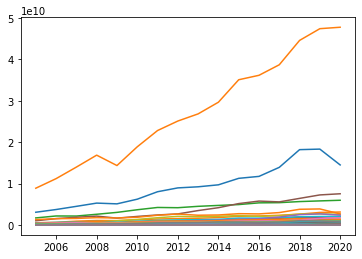

In [333]:
# Проверка на выбросы
for i in regional_production.index:
    plt.plot(range(2005,2021), regional_production.iloc[i,range(2,18)])

In [765]:
regional_production.to_csv('data/regional_production.csv')

## retail_turnover

In [999]:
retail_turnover = pd.read_excel('data/social_russia_data/retail_turnover_per_capita_2000_2021.xls')

In [1000]:
# Переименновываем столбцы и удаляем ненужные строчки
cols = retail_turnover.loc[1].values
cols[0] = 'region'
retail_turnover.columns = cols
retail_turnover = retail_turnover.drop([0,1,2]).reset_index(drop=True)
retail_turnover = retail_turnover.drop(retail_turnover.columns[1], axis=1)

In [1001]:
# Удаляем федеральные округи
mask = []
for i in retail_turnover.index:
    mask.append(not ('федеральный округ' in retail_turnover['region'].loc[i]))
retail_turnover = retail_turnover.loc[mask].reset_index(drop=True)

### Работа с пропусками и названиями регионов

In [1002]:
# Пропуски
retail_turnover.loc[retail_turnover.isna().sum(axis=1).loc[retail_turnover.isna().sum(axis=1)!=0].index]

,region,2000,2001,2002,2003,2004,2005,2006,2007,2008,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
23,Архангельская область (без АО),0,0,0,0,0,0,0,0,0,...,0,154177,176420,194345,NaN,NaN,NaN,NaN,NaN,NaN
34,Республика Крым,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,79010,112916,115133,120177,133940,143660,148071,176044
39,Город федерального значения Севастополь,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,90459,94360,145575,146264,149255,154734,141383,187776
54,"Коми-Пермяцкий округ, входящий в с...",3569,4930,7171,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Тюменская область (без АО),0,0,0,0,0,0,0,0,0,...,0,204811,217731,226531,NaN,NaN,NaN,NaN,NaN,NaN
75,Таймырский (Долгано-Ненецкий) авто...,20134,25091,26127,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
76,Эвенкийский автономный округ (Крас...,10965,14964,19848,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
78,Усть-Ордынский Бурятский округ,3456,4077,4556,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
85,Агинский Бурятский округ (Забайкал...,5843,9027,12806,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
88,"Корякский округ, входящий в состав...",15822,20141,22554,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1003]:
# Убираем отступы
retail_turnover['region'] = retail_turnover['region'].apply(lambda x: x.split('  ')[-1])

In [1004]:
# Заменяем нули на пропуски
retail_turnover = retail_turnover.replace(0, np.NAN)

In [1005]:
# Смотрим Архангельскую область
regions = ['Архангельская область',
       'Ненецкий автономный округ (Архангельская область)',
       'Архангельская область (без АО)',
       'Архангельская область (кроме Ненецкого автономного округа)']
mask = []
for i in retail_turnover.index:
    mask.append(retail_turnover.loc[i,'region'] in regions)
retail_turnover[mask]

,region,2000,2001,2002,2003,2004,2005,2006,2007,2008,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
21,Архангельская область,11845.0,17821.0,21924.0,26959.0,33554.0,41707.0,50781.0,61423.0,79990.0,...,135625.0,154320.0,176491.0,194266.0,203019.0,217241.0,229576.0,239516.0,249101.0,278284.0
22,Ненецкий автономный округ (Архангельская область),13040.0,21404.0,26254.0,32808.0,38974.0,51057.0,63280.0,79578.0,94223.0,...,145446.0,158161.0,178374.0,192201.0,204097.0,214927.0,220864.0,223587.0,226206.0,235547.0
23,Архангельская область (без АО),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,154177.0,176420.0,194345.0,NaN,NaN,NaN,NaN,NaN,NaN
24,Архангельская область (кроме Ненецкого автоном...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,154177.0,176420.0,194345.0,202977.0,217332.0,229922.0,240155.0,250033.0,280050.0


In [1006]:
# Смотрим Тюменскую область
regions = ['Тюменская область',
       'Ханты-Мансийский автономный округ - Югра (Тюменская область)',
       'Ямало-Ненецкий автономный округ (Тюменская область)',
       'Тюменская область (без АО)',
       'Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)',]
mask = []
for i in retail_turnover.index:
    mask.append(retail_turnover.loc[i,'region'] in regions)
retail_turnover[mask]

,region,2000,2001,2002,2003,2004,2005,2006,2007,2008,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
64,Тюменская область,19638.0,26698.0,33632.0,44680.0,56710.0,74022.0,98384.0,126927.0,165587.0,...,187416.0,211812.0,223265.0,230504.0,226307.0,238401.0,254256.0,262514.0,262970.0,293631.0
65,Ханты-Мансийский автономный округ - Югра (Тюме...,21482.0,29731.0,37327.0,52381.0,67805.0,88011.0,117179.0,151013.0,192562.0,...,192753.0,214602.0,224038.0,229048.0,224137.0,239076.0,253455.0,262109.0,258117.0,288977.0
66,Ямало-Ненецкий автономный округ (Тюменская обл...,26138.0,34725.0,43664.0,53012.0,68062.0,92616.0,119293.0,149563.0,191602.0,...,201376.0,221694.0,235512.0,245559.0,229235.0,237608.0,256402.0,261956.0,263114.0,293712.0
67,Тюменская область (без АО),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,204811.0,217731.0,226531.0,NaN,NaN,NaN,NaN,NaN,NaN
68,Тюменская область (кроме Ханты-Мансийского авт...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,204811.0,217731.0,226531.0,227659.0,237939.0,254370.0,263154.0,268215.0,298699.0


Пропуски заполнить не получится, т.к. данные рассчитаны на душу населения. Для предсказания данных достаточно, будем использовать так.

In [1008]:
indexes_to_drop = retail_turnover[(retail_turnover['region']=='Архангельская область')|
                                  (retail_turnover['region']=='Архангельская область (без АО)')|
                                  (retail_turnover['region']=='Тюменская область')|
                                  (retail_turnover['region']=='Тюменская область (без АО)')].index
retail_turnover = retail_turnover.drop(indexes_to_drop).reset_index(drop=True)

In [1015]:
regions = retail_turnover['region'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
set()


In [1013]:
retail_turnover = retail_turnover.replace({
    'Город Москва столица Российской Федерации город федерального значения': 'город Москва',
    'Город Санкт-Петербург город федерального значения': 'город Санкт-Петербург',
    'Город федерального значения Севастополь': 'город Севастополь',
    'Тюменская область (кроме Ханты-Мансийского автономного округа-Югры и Ямало-Ненецкого автономного округа)': 'Тюменская область (без автономных округов)'
})

In [1014]:
# Удаляем ненужные
regions = list(set(retail_turnover['region']) - set(child_mortality_coefficient.columns))
indexes_to_drop = []
for i in retail_turnover.index:
    if retail_turnover.loc[i,'region'] in regions:    
        indexes_to_drop.append(i)
retail_turnover = retail_turnover.drop(indexes_to_drop).reset_index(drop=True)

In [779]:
# Пропуски есть только в начале, они не помешают предсказаниям
retail_turnover.loc[retail_turnover.isna().sum(axis=1).loc[retail_turnover.isna().sum(axis=1)!=0].index]

,region,2000,2001,2002,2003,2004,2005,2006,2007,2008,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
23,Архангельская область (кроме Ненецкого автоном...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,154177.0,176420.0,194345.0,NaN,NaN,NaN,NaN,NaN,NaN
24,Архангельская область (кроме Ненецкого автоном...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,154177.0,176420.0,194345.0,202977.0,217332.0,229922.0,240155.0,250033.0,280050.0
34,Республика Крым,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,79010.0,112916.0,115133.0,120177.0,133940.0,143660.0,148071.0,176044.0
39,город Севастополь,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,90459.0,94360.0,145575.0,146264.0,149255.0,154734.0,141383.0,187776.0
45,Чеченская Республика,NaN,NaN,NaN,NaN,8076.0,10242.0,8947.0,13268.0,24235.0,...,69225.0,77088.0,88310.0,106136.0,108534.0,111074.0,115781.0,120058.0,123955.0,141300.0
66,Тюменская область (без автономных округов),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,204811.0,217731.0,226531.0,NaN,NaN,NaN,NaN,NaN,NaN
67,Тюменская область (без автономных округов),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,204811.0,217731.0,226531.0,227659.0,237939.0,254370.0,263154.0,268215.0,298699.0
74,Ненецкий автономный округ (Архангельская область),20134.0,25091.0,26127.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1016]:
# Транспонируем таблицу
df = retail_turnover.T
df.columns = df.loc['region'].values
df = df.drop('region', axis=0)
retail_turnover = df

### Проверка на выбросы

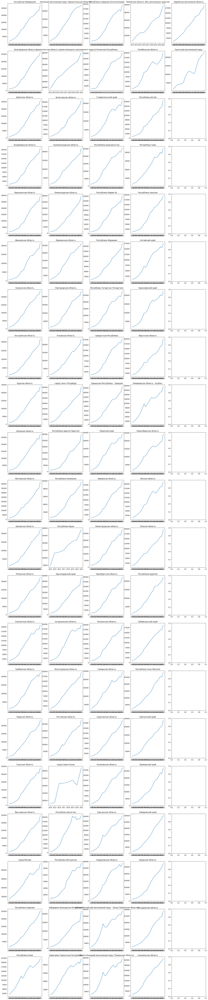

In [351]:
fig, axs = plt.subplots(21,5, figsize=(24,123))
for i, col in enumerate(retail_turnover.columns):
    if i<21:
        axs[i,0].plot(retail_turnover[col])
        axs[i,0].set_title(col)
    elif i<42:
        axs[i-21,1].plot(retail_turnover[col])
        axs[i-21,1].set_title(col)
    elif i<63:
        axs[i-42,2].plot(retail_turnover[col])
        axs[i-42,2].set_title(col)
    elif i<84:
        axs[i-63,3].plot(retail_turnover[col])
        axs[i-63,3].set_title(col)
    elif i<88:
        axs[i-84,4].plot(retail_turnover[col])
        axs[i-84,4].set_title(col)
plt.show()

In [1018]:
# Аномальных значений нет
retail_turnover.to_csv('data/retail_turnover.csv')

## crimes

### Создаём таблицу

In [1027]:
# Записываем в crimes списки. 
# Каждый список содержит таблицы "Строка 1-5" для суммарных преступлений в каждом году.
crimes = []
for i in range(6):
    year_i = []
    for j in range(5):
        if i<5:
            year_i.append(pd.read_excel(
                'data/social_russia_data/crimes/4-EGS_Razdel_4_1220'+str(16+i)+'.xls',
                sheet_name='Строка '+str(j+1) 
                ))
        else: 
            year_i.append(pd.read_excel(
                'data/social_russia_data/crimes/4-EGS_Razdel_5_1220'+str(16+i)+'.xls',
                sheet_name='Строка '+str(j+1) 
                ))
    crimes.append(year_i)

WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** file size (122053) not 512 + multiple of sector size (512)
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** file size (122053) not 512 + multiple of sector size (512)
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** file size (122053) not 512 + multiple of sector size (512)
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** file size (122053) not 512 + multiple of sector size (512)
WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
WARNING *** file size (122053) not 512 + multiple of sector

In [1028]:
cols = ['to_drop', 'region']
cols.extend(list(range(1,11)))
for i in range(6):
    for j in range(5):
        df = crimes[i][j].iloc[:,list(range(12))] # Оставляем преступления от 1 до 10
        df.columns = cols
        df = df.drop('to_drop', axis=1)
        df = df.drop(list(range(11))).reset_index(drop=True)
        df['Строка'] = j+1 # Обозначаем номер "Строки" из файла (он отвечает за тяжесть преступления)
        crimes[i][j] = df

In [1029]:
# Объединяем таблицы за один год с разным уровнем тяжести
crimes_merged = []
for i in range(6):
    df = crimes[i][0]
    for j in range(1,5):
        df = pd.concat([df,crimes[i][j]]).reset_index(drop=True)
    crimes_merged.append(df)

In [1030]:
# Делим таблицы под отдельному типу преступления
crimes_by_type = []
for i in range(6):
    row_i = []
    for col in range(1,11):
        df = crimes_merged[i].loc[:,['region','Строка',col]]
        df['type'] = col
        df = df.rename(columns={col:2016+i})
        row_i.append(df)
    crimes_by_type.append(row_i)

In [1031]:
# Объединяем таблицы с одинаковым годом
crimes_merged = []
for i in range(6):
    df = crimes_by_type[i][0]
    for j in range(1,10):
        df = pd.concat([df,crimes_by_type[i][j]]).reset_index(drop=True)
    crimes_merged.append(df)

In [1032]:
# Нашлись несовпадения в названиях регионов разных таблиц
for i in range(6):
    crimes_merged[i] = crimes_merged[i].replace({
        'Кемеровская область':'Кемеровская область – Кузбасс',
        'Республика Северная Осетия – Алания':'Республика Северная Осетия-Алания',
        'Ханты-Мансийский автономный округ –  Югра':'Ханты-Мансийский автономный округ - Югра'
    })

In [1033]:
# Объединяем таблицы за разные года
crimes = crimes_merged[0]
for i in range(1,6):
    crimes = pd.merge(crimes,crimes_merged[i],on=['region','Строка','type'])

In [1034]:
# Меняем столбцы местами для красоты
crimes[2016], crimes['type'] = crimes['type'], crimes[2016]
cols = list(crimes.columns)
cols[2], cols[3] = cols[3], cols[2]
crimes.columns = cols

In [1035]:
# Переименновываем значения "Строка" на соответствующую тяжесть
crimes['Строка'] = crimes['Строка'].replace({
    1:'Всего',2:'особо тяжких',3:'тяжких',4:'средней тяжести',5:'небольшой тяжести'
})
crimes = crimes.rename(columns={'Строка':'gravity'})
# Переименновываем типы преступлений соответственно
crimes['type'] = crimes['type'].replace({
    1:'несовершеннолетними или при их соучастии',
    2:'ранее совершавшими преступления',
    3:'ранее судимыми (из совершивших преступление)',
    4:'группой лиц',
    5:'группой лиц по предварительному сговору',
    6:'организованной группой',
    7:'преступным сообществом (преступной организацией)',
    8:'в состоянии опьянения: алкогольного',
    9:'в состоянии опьянения: наркотического',
    10:'в состоянии опьянения: токсического'
})

In [1036]:
# Удаляем федеральные округи
mask = []
for i in crimes.index:
    mask.append(not ('федеральный округ' in crimes['region'].loc[i])) 
crimes = crimes.loc[mask].reset_index(drop=True)

### Переименновываем регионы

Наблюдая данные в таюлицах можно заметить, что под Архангельской и Тюменской областями подразумеваются
области без АО 

In [1038]:
crimes = crimes.replace(rename_regions(crimes['region'].unique()))

In [1039]:
regions = crimes['region'].unique()
print(set(final_df.index) - set(regions))
print(set(regions) - set(final_df.index))

set()
{'УТ МВД по Дальневосточному ФО', 'УТ МВД по Приволжскому ФО', 'УТ МВД по Сибирскому ФО', 'УТ МВД по Уральскому ФО', 'Транспорт России', 'УТ МВД по Северо-Западному ФО', 'УТ МВД по Южному ФО', 'УТ МВД по Центральному ФО', 'УТ МВД по Северо-Кавказскому ФО'}


In [1040]:
# Удаляем ненужные
regions_to_drop = list(set(crimes['region']) - set(child_mortality_coefficient.columns))
indexes = []
for i in crimes.index:
    if crimes.loc[i,'region'] in regions_to_drop:
        indexes.append(i)
crimes = crimes.drop(indexes).reset_index(drop=True)

### Проверка на пропуски

In [796]:
crimes.isna().sum().loc[crimes.isna().sum()!=0]

Series([], dtype: int64)

Пропусков нету, но возможно есть замаскированные под 0 пропуски, но как их проверить, пока не ясно.

### Проверка на выбросы

In [381]:
# Сгруппируем по средним значениям, чтобы проверить на выбросы на графиках.
crimes_copy = crimes.copy()
crimes_copy['mean'] = crimes_copy.iloc[:,range(3,9)].mean(axis=1)

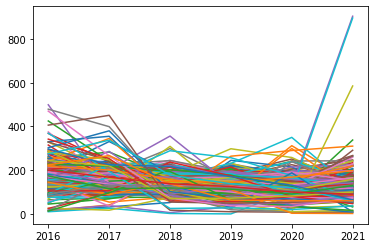

In [396]:
df = crimes_copy[(crimes_copy['mean']>100)&(crimes_copy['mean']<200)]
fig, ax = plt.subplots()
for i in df.index:
    plt.plot(range(2016,2022),df.loc[i,range(2016,2022)])

Выбросы присутствуют, но так как данных очень много, отыскивать их сложно. Эти данные не годятся для предсказания, поэтому будем использовать среднее.

In [1041]:
crimes.to_csv('data/crimes.csv')

## crimes_coefficient

In [798]:
crimes_coefficient = pd.read_csv('data/crimes.csv', index_col='Unnamed: 0')
population = pd.read_csv('data/population.csv', index_col='Unnamed: 0')

In [799]:
for i in crimes_coefficient.index:
    region = crimes_coefficient.loc[i,'region']
    for year in range(2016,2022):
        region_population = population.loc[year,region]
        crimes_coefficient.loc[i,str(year)] = round(crimes_coefficient.loc[i,str(year)]/region_population * 100000,3)

In [800]:
crimes_coefficient.to_csv('data/crimes_coefficient.csv')

## Изучаем методы предсказаний

In [ ]:
child_mortality_coefficient = pd.read_csv('data/child_mortality_coefficient.csv')
child_mortality_coefficient['date'] = child_mortality_coefficient['Unnamed: 0'].apply(lambda x:
    pd.Timestamp(year=int(x),month=1,day=1))
child_mortality_coefficient.index = child_mortality_coefficient['date']
child_mortality_coefficient = child_mortality_coefficient.drop(['Unnamed: 0','date'], axis=1)
child_mortality_coefficient.index = pd.DatetimeIndex(child_mortality_coefficient.index.values,
                               freq=child_mortality_coefficient.index.inferred_freq)

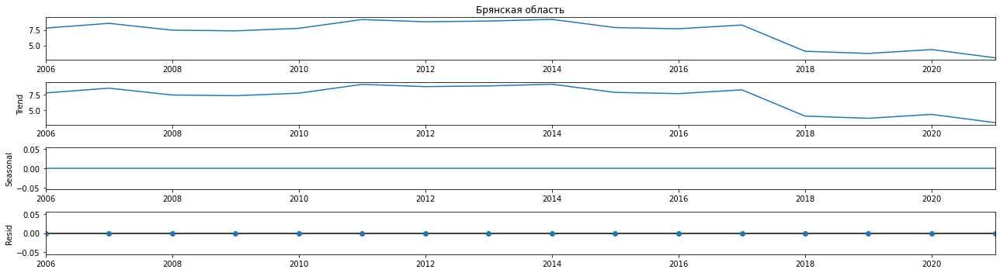

In [ ]:
from statsmodels.tsa.stattools import adfuller
import statsmodels.graphics.tsaplots as sgt
from statsmodels.tsa.seasonal import seasonal_decompose
seasonal_decompose(child_mortality_coefficient['Брянская область']).plot();

In [ ]:
def stat_test(df):
    test = adfuller(df)
    print ('adf: ', test[0] )
    print ('p-value: ', test[1])
    print('Critical values: ', test[4])
    if test[0]> test[4]['5%']: 
        print ('есть единичные корни, ряд не стационарен')
    else:
        print ('единичных корней нет, ряд стационарен')

stat_test(child_mortality_coefficient['Брянская область'].diff().dropna())

adf:  -4.195334085266265
p-value:  0.0006709861607829396
Critical values:  {'1%': -4.01203360058309, '5%': -3.1041838775510207, '10%': -2.6909873469387753}
единичных корней нет, ряд стационарен


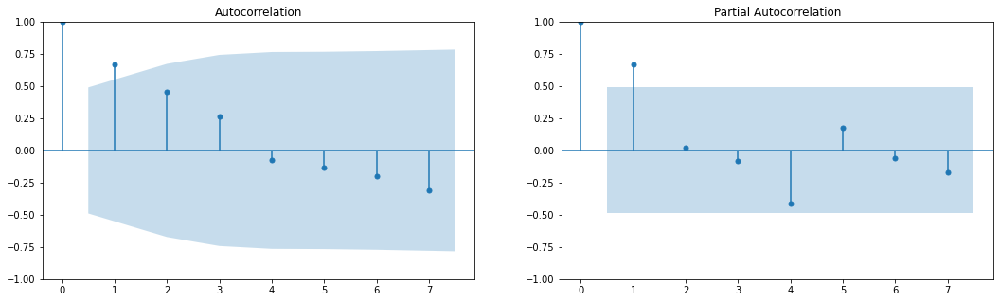

In [ ]:
def plot_acf_pacf(series):
    plt.rcParams["figure.figsize"] = 18, 5

    fig, axes = plt.subplots(1, 2)

    sgt.plot_acf(series, ax=axes[0], lags=7)
    sgt.plot_pacf(series, ax=axes[1], lags=7, method="ywm")
    plt.show()
    
plot_acf_pacf(child_mortality_coefficient['Брянская область'])

ARIMA

In [ ]:
from statsmodels.tsa.arima.model import ARIMA
p=2
d=1
q=2
arima_model = ARIMA(child_mortality_coefficient['Брянская область'].dropna(), order=(p,d,q))
arima_model_fit = arima_model.fit()
arima_model_fit.summary()

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:       Брянская область   No. Observations:                   16
Model:                 ARIMA(2, 1, 2)   Log Likelihood                 -24.099
Date:                Mon, 11 Sep 2023   AIC                             58.197
Time:                        12:47:27   BIC                             61.738
Sample:                    01-01-2006   HQIC                            58.160
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.3873      1.198     -1.158      0.247      -3.734       0.960
ar.L2         -0.8872      0.862     -1.029      0.303      -2.576       0.802
ma.L1          1.6863    156.722      0.011      0.991    -305.483     308.855
ma.L2          0.9980    185.402      0.005      0.996    -362.384     364.380
sigma2         1.1621    214.372      0.005      0.996    -419.000     421.324
===================================================================================
Ljung-Box (L1) (Q):                   0.69   Jarque-Bera (JB):                10.26
Prob(Q):                              0.41   Prob(JB):                         0.01
Heteroskedasticity (H):               2.95   Skew:                            -1.30
Prob(H) (two-sided):                  0.26   Kurtosis:                         6.10
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
pred_df = pd.DataFrame()
pred_df['model_preds'] = arima_model_fit.predict(start=child_mortality_coefficient.index[-1]+pd.DateOffset(years=1),end=child_mortality_coefficient.index[-1]+pd.DateOffset(years=10))
pred_df

,model_preds
2022-01-01,3.764215
2023-01-01,3.777743
2024-01-01,3.067155
2025-01-01,4.040937
2026-01-01,3.320448
2027-01-01,3.456049
2028-01-01,3.907134
2029-01-01,3.161051
2030-01-01,3.795883
2031-01-01,3.577102


In [ ]:
forecast = arima_model_fit.get_forecast(10)
forecast_df = forecast.conf_int(alpha=0.05)
forecast_df['prediction'] = (forecast_df['lower Брянская область'] + forecast_df['upper Брянская область'])/2

In [ ]:
forecast_df

,lower Брянская область,upper Брянская область,prediction
2022-01-01,1.538448,5.989982,3.764215
2023-01-01,0.280146,7.275340,3.777743
2024-01-01,-0.993452,7.127761,3.067155
2025-01-01,-0.741917,8.823791,4.040937
2026-01-01,-2.051065,8.691960,3.320448
2027-01-01,-2.328264,9.240362,3.456049
2028-01-01,-2.449236,10.263504,3.907134
2029-01-01,-3.572932,9.895035,3.161051
2030-01-01,-3.339752,10.931518,3.795883
2031-01-01,-3.995428,11.149632,3.577102


Exponential Smoothing

In [ ]:
from statsmodels.tsa.api import SimpleExpSmoothing
# Подбираем alpha
alpha_dict = dict()
for alpha in np.linspace(0.8,0.9,21).round(3):
    ses = SimpleExpSmoothing(child_mortality_coefficient['Брянская область'])
    model = ses.fit(smoothing_level = alpha)
    exp_pred = model.forecast(1)
    alpha_dict[alpha] = model.aic
    #print('Prdiction:{0}, \n AIC:{1}'.format(exp_pred, model.aic))

In [ ]:
alpha = sorted(alpha_dict.items(), key=lambda x:x[1])[0][0]
ses = SimpleExpSmoothing(child_mortality_coefficient['Брянская область'])
model = ses.fit(smoothing_level = alpha)
exp_pred = model.forecast(1)
alpha_dict[alpha] = model.aic
print('Prdiction:{0}, \n AIC:{1}'.format(exp_pred, model.aic))

Prdiction:2022-01-01    3.162215
Freq: AS-JAN, dtype: float64, 
 AIC:12.084928915628637


In [ ]:
from statsmodels.tsa.api import Holt
alpha = sorted(alpha_dict.items(), key=lambda x:x[1])[0][0]
beta = 0
holt = Holt(child_mortality_coefficient['Брянская область'])
model = holt.fit(smoothing_level = alpha, smoothing_trend = beta)
exp_pred = model.forecast(10)
alpha_dict[alpha] = model.aic
print('Prdiction:{0}, \n AIC:{1}'.format(exp_pred, model.aic))

Prdiction:2022-01-01    2.787361
2023-01-01    2.464987
2024-01-01    2.142613
2025-01-01    1.820238
2026-01-01    1.497864
2027-01-01    1.175489
2028-01-01    0.853115
2029-01-01    0.530741
2030-01-01    0.208366
2031-01-01   -0.114008
Freq: AS-JAN, dtype: float64, 
 AIC:14.789867710330352


Damped Double Exponential Smoothing

In [ ]:
from statsmodels.tsa.api import ExponentialSmoothing
#alpha = sorted(alpha_dict.items(), key=lambda x:x[1])[0][0]
# Подбираем alpha и beta
alpha_beta_dict = dict()
for alpha in np.linspace(0.6,1,41).round(3):
    for beta in np.linspace(0,0.3,31).round(3):
        es = ExponentialSmoothing(child_mortality_coefficient['Брянская область'], trend='mul', seasonal=None, damped_trend=True)
        model = es.fit(smoothing_level = alpha, smoothing_trend=beta)
        alpha_beta_dict[(alpha,beta)] = model.aic

In [ ]:
alpha = sorted(alpha_beta_dict.items(), key=lambda x:x[1])[0][0][0]
beta = sorted(alpha_beta_dict.items(), key=lambda x:x[1])[0][0][1]
es = ExponentialSmoothing(child_mortality_coefficient['Брянская область'], trend='mul',seasonal=None, damped_trend=True)
model = es.fit(smoothing_level=alpha, smoothing_trend=beta)
exp_pred = model.forecast(10)
print('Prdiction:{0}, \n AIC:{1}'.format(exp_pred, model.aic))

Prdiction:2022-01-01    3.083009
2023-01-01    2.979556
2024-01-01    2.880067
2025-01-01    2.784373
2026-01-01    2.692313
2027-01-01    2.603734
2028-01-01    2.518491
2029-01-01    2.436444
2030-01-01    2.357461
2031-01-01    2.281414
Freq: AS-JAN, dtype: float64, 
 AIC:16.8412664034496


## Forecusting function

Критерий AIC у экспоненциального сглаживания гораздо лучше, чем у ARIMA. Простое экспоненциальное сглаживание хорошо подходит для предсказывания только на следубщий год, но нам нужны предсказания на 2 или 3 года вперёд.Будем использовать двойное экспоненциальное сглаживание, вместо одинарного (простого), т.к. в данных присутствует тренд. Учтём тот факт, что если в каком-либо регионе не вводятся мер улучшения жизни, то соответствующие тенденции будут слабо меняться и со временем станет стационарным (например, если не вводить мер по улучшению здравоохранения в регионе, коэффициент младенческой смертности не будет меняться, если не учитывать всяке внешние факторы, вроде эпидемий). Из этих соображений будем использовать затухающий со временем тренд в экспоненциальном сглаживании. 

In [ ]:
# Функция предсказаний
def forecast_df(df, forecast_number):
    df_pred = pd.DataFrame()
    for col in df.columns:
        mask = ~df[col].isna() # У некоторых столбцов есть пропуски в начале, которые не заполнить. Убираем их.
        # Подбираем параметры alpha и beta
        alpha_beta_dict = dict()
        for alpha in np.linspace(0.7,1,5):
            for beta in np.linspace(0,0.3,5):
                es = ExponentialSmoothing(df[col][mask], trend='add',seasonal=None, damped_trend=True)
                model = es.fit(smoothing_level=alpha, smoothing_trend=beta)
                alpha_beta_dict[(alpha,beta)] = model.aic
                
        alpha = sorted(alpha_beta_dict.items(), key=lambda x:x[1])[0][0][0]
        beta = sorted(alpha_beta_dict.items(), key=lambda x:x[1])[0][0][1]
        es = ExponentialSmoothing(df[col][mask], trend='add',seasonal=None, damped_trend=True)
        model = es.fit(smoothing_level=alpha, smoothing_trend=beta)
        exp_pred = model.forecast(forecast_number)
        for i in range(exp_pred.shape[0]):
            df_pred.loc[exp_pred.index[i],col] = exp_pred.values[i]
    return df_pred

## final_df

In [897]:
final_df = pd.DataFrame(index=child_mortality_coefficient.columns)

### Добавляем смертность младенцев

In [898]:
child_mortality_coefficient = pd.read_csv('data/child_mortality_coefficient.csv', index_col='Unnamed: 0')

In [899]:
# Приводим индексы в формат datetime
child_mortality_coefficient.index = [pd.Timestamp(year=int(x), month=1, day=1) for x in child_mortality_coefficient.index]
child_mortality_coefficient.index = pd.DatetimeIndex(child_mortality_coefficient.index.values,
                               freq=child_mortality_coefficient.index.inferred_freq)

In [900]:
# Делаем предсказания до 2023 и заносим их в таблицу
pred_df = forecast_df(df=child_mortality_coefficient,forecast_number=2)

In [902]:
pred_df

,Российская Федерация,Белгородская область,Брянская область,Владимирская область,Воронежская область,Ивановская область,Калужская область,Костромская область,Курская область,Липецкая область,...,Камчатский край,Приморский край,Хабаровский край,Амурская область,Магаданская область,Сахалинская область,Еврейская автономная область,Чукотский автономный округ,город Москва,город Санкт-Петербург
2022-01-01,4.465516,4.171890,2.878592,6.396044,3.981941,3.006909,2.925399,4.871789,3.453683,3.362364,...,4.451725,4.954972,3.864760,4.386283,5.012184,3.248919,9.955040,15.085638,3.225308,3.544797
2023-01-01,4.300183,4.148784,2.578321,6.353141,3.784844,2.669444,2.488058,4.822068,3.062679,3.079539,...,4.046263,4.597313,3.362271,3.977599,4.896644,3.191412,9.616482,15.003366,2.957387,3.481490


In [903]:
final_df['child_mortality_coefficient'] = pred_df.loc[pd.Timestamp('2023-01-01')]

In [905]:
final_df.to_csv('data/final_df.csv')

### Добавляем заболеваемость

In [906]:
morbidity = pd.read_csv('data/morbidity.csv', index_col='Unnamed: 0')
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [907]:
from tqdm import tqdm
for age in tqdm(morbidity['Age_group'].unique()):
    for disease in morbidity['Disease'].unique():
        # Отделяем таблицу с конкретной болезнью и возрастной группой
        df = morbidity[(morbidity['Age_group']==age)&(morbidity['Disease']==disease)].reset_index(drop=True)
        df = df.drop(['Disease','Age_group'], axis=1)
        # Транспонируем таблицу и переводим индекс в формат datetime
        df_step = df.T
        df_step.columns = df_step.loc['Region'].values
        df_step = df_step.drop('Region')
        df_step.index = [pd.Timestamp(year=int(float(x)),month=1, day=1) for x in df_step.index]
        df = df_step.astype(float)
        df.index = pd.DatetimeIndex(df.index.values,
                                    freq=df.index.inferred_freq)
        df_mean = df.mean()
        if df_mean.isna().sum() > 0:
            continue 
        final_df[disease+'_'+age] = df_mean

100%|██████████| 4/4 [00:00<00:00, 13.06it/s]


In [ ]:
# (время ожидания ~8 мин.)
from tqdm import tqdm
for age in tqdm(morbidity['Age_group'].unique()):
    for disease in morbidity['Disease'].unique():
        # Отделяем таблицу с конкретной болезнью и возрастной группой
        df = morbidity[(morbidity['Age_group']==age)&(morbidity['Disease']==disease)].reset_index(drop=True)
        df = df.drop(['Disease','Age_group'], axis=1)
        # Транспонируем таблицу и переводим индекс в формат datetime
        df_step = df.T
        df_step.columns = df_step.loc['Region'].values
        df_step = df_step.drop('Region')
        df_step.index = [pd.Timestamp(year=int(float(x)),month=1, day=1) for x in df_step.index]
        df = df_step.astype(float)
        df.index = pd.DatetimeIndex(df.index.values,
                                    freq=df.index.inferred_freq)
        # Делаем предсказания до 2023 года с помощью Exponential Smoothing 
        df_pred = forecast_df(df=df,forecast_number=7)
        # Учтём, что у некоторых болезней есть только одна возрастная группа
        if df_pred.shape[0]==0:
            print((age, disease))
            continue    
        # Некоторые предсказанные значения отрицательны, но реальные значения не могут опуститься ниже нуля. Заменим их на ноль.    
        final_df[disease+'_'+age] = df_pred.iloc[-1].apply(lambda x: 0 if x<0 else x)

  0%|          | 0/4 [00:00<?, ?it/s]

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

('15-17 лет', 'Отдельные состояния, возникающие в перинатальном периоде')


c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

('18 лет и старше', 'Отдельные состояния, возникающие в перинатальном периоде')


c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

('Всего', 'Отдельные состояния, возникающие в перинатальном периоде')


c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
 75%|███████▌  | 3/4 [05:51<01:57, 117.85s/it]

('0-14 лет', 'Беременность, роды и послеродовой период')


c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

In [910]:
final_df.to_csv('data/final_df.csv')

### Добавляем популяцию

In [911]:
population = pd.read_csv('data/population.csv', index_col='Unnamed: 0')
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [912]:
population.index = [pd.Timestamp(year=x, month=1, day=1) for x in population.index]
population.index = pd.DatetimeIndex(population.index.values,
                               freq=population.index.inferred_freq)

In [913]:
# Делаем предсказание на 2023-ий год
df_pred = forecast_df(df=population, forecast_number=1).round()

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

In [914]:
df_pred

,Российская Федерация,Белгородская область,Брянская область,Владимирская область,Воронежская область,Ивановская область,Калужская область,Костромская область,Курская область,Липецкая область,...,Забайкальский край,Республика Саха (Якутия),Камчатский край,Приморский край,Хабаровский край,Амурская область,Магаданская область,Сахалинская область,Еврейская автономная область,Чукотский автономный округ
2023-01-01,145335930.0,1530160.0,1158534.0,1312884.0,2277389.0,968175.0,1014853.0,615476.0,1076378.0,1105076.0,...,1036584.0,996879.0,312232.0,1851275.0,1293115.0,766205.0,136252.0,482900.0,152122.0,49673.0


In [915]:
final_df['population'] = df_pred.loc[pd.Timestamp('2023-01-01')]

In [916]:
final_df.to_csv('data/final_df.csv')

### Добавляем коэффициент инвалидности

In [917]:
invalidity_coefficient = pd.read_csv('data/invalidity_coefficient.csv', index_col='Unnamed: 0')

In [918]:
age_groups = list(invalidity.columns)
age_groups.remove('region')
age_groups.remove('date')
age_groups

['total', '18_30', '31_40', '41_50', '51_60', '60_']

In [919]:
# (время ожидания ~1мин.)
for age_group in age_groups:
    # Составляем таблицу для отдельной возрастной группы
    df = pd.pivot_table(data=invalidity_coefficient, index='date', columns='region', values=age_group)
    # Переводим индекс в формат datetime
    df.index = pd.to_datetime(df.index)
    df.index = pd.DatetimeIndex(df.index.values, freq=df.index.inferred_freq) # фиксируем частоту
    # Делаем предсказание до января 2023 года
    df_pred = forecast_df(df=df,forecast_number=13)
    # Добавляем предсказание в final_df
    final_df['invalidity_coefficient'+'_'+age_group] = df_pred.iloc[-1]

In [920]:
final_df.to_csv('data/final_df.csv')

### Добавляем наркоманию и алкоголизм

In [921]:
alco = pd.read_csv('data/alco.csv', index_col='Unnamed: 0')
drug = pd.read_csv('data/drug.csv', index_col='Unnamed: 0')

In [922]:
# Переводим индексы в формат datetime
alco.index = pd.to_datetime(alco.index)
alco.index = pd.DatetimeIndex(alco.index.values, freq=alco.index.inferred_freq) # фиксируем частоту
drug.index = pd.to_datetime(drug.index)
drug.index = pd.DatetimeIndex(drug.index.values, freq=drug.index.inferred_freq) # фиксируем частоту

In [923]:
alco_pred = forecast_df(df=alco, forecast_number=5)
drug_pred = forecast_df(df=drug, forecast_number=5)

In [924]:
# Предположим, что 20 процентов зависимых излечились. Добавляем в таблицу оставшихся зависимых.
final_df['alco'] = pd.concat([alco, alco_pred]).sum(axis=0)*0.8
final_df['drug'] = pd.concat([drug, drug_pred]).sum(axis=0)*0.8
# В Крыму и Севастополе предсказания и суммирование смысла не имеют, ведь известно данные всего за 2 года. 
# Поставим там среднее за известные 2 года.
final_df.loc['город Севастополь',['alco','drug']] = [alco['город Севастополь'].mean(),drug['город Севастополь'].mean()]
final_df.loc['Республика Крым',['alco','drug']] = [alco['Республика Крым'].mean(),drug['Республика Крым'].mean()]

In [925]:
final_df.to_csv('data/final_df.csv')

### Добавляем данные о процентной бедности

In [926]:
poverty = pd.read_csv('data/poverty.csv', index_col='Unnamed: 0')
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [927]:
poverty.index = [pd.Timestamp(x) for x in poverty.index]
poverty.index = pd.DatetimeIndex(poverty.index.values,
                               freq=poverty.index.inferred_freq)

In [928]:
pred_df = forecast_df(df=poverty, forecast_number=3)

In [929]:
pred_df

,Алтайский край,Амурская область,Архангельская область (кроме Ненецкого автономного округа),Астраханская область,Белгородская область,Брянская область,Владимирская область,Волгоградская область,Вологодская область,Воронежская область,...,Удмуртская Республика,Ульяновская область,Хабаровский край,Ханты-Мансийский автономный округ - Югра (Тюменская область),Челябинская область,Чеченская Республика,Чувашская Республика - Чувашия,Чукотский автономный округ,Ямало-Ненецкий автономный округ (Тюменская область),Ярославская область
2021-01-01,17.468261,15.021324,12.094829,15.303661,7.088551,13.548822,12.334785,11.479757,12.499231,7.972212,...,11.240314,14.953605,11.579438,8.428862,12.531879,20.469183,16.574710,8.092098,5.033126,9.476678
2022-01-01,17.442869,14.878383,11.923150,15.024749,6.999392,13.507880,12.202613,11.081202,12.224106,7.447062,...,10.638336,14.916490,11.173094,8.421990,12.477382,20.524529,16.394478,8.019417,5.022918,9.055473
2023-01-01,17.422556,14.764030,11.785806,14.762240,6.928065,13.475126,12.096875,10.703218,11.950356,6.924538,...,10.051818,14.886797,10.780487,8.416492,12.433784,20.568806,16.250293,7.961273,5.014752,8.636374


In [930]:
final_df['poverty_percent'] = pred_df.iloc[-1]

In [931]:
final_df.to_csv('data/final_df.csv')

### Добавляем poverty_socdem

In [932]:
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')
poverty_socdem = pd.read_csv('data/poverty_socdem.csv', index_col='Unnamed: 0')
poverty_socdem

,Дети в возрасте до 16 лет,Население старше трудоспособного возраста
Российская Федерация,39.60,6.55
Белгородская область,44.10,12.35
Брянская область,41.60,3.35
Владимирская область,41.85,8.45
Воронежская область,35.60,6.95
...,...,...
Амурская область,40.25,5.30
Магаданская область,31.45,13.15
Сахалинская область,34.65,5.35
Еврейская автономная область,34.85,8.65


In [933]:
final_df['Дети в возрасте до 16 лет среди малоимущих'] = poverty_socdem['Дети в возрасте до 16 лет']
final_df['Население старше трудоспособного возраста среди малоимущих'] = poverty_socdem['Население старше трудоспособного возраста']

In [934]:
final_df.to_csv('data/final_df.csv')

### Добавляем расходы на социальную политику

In [935]:
welfare_expense = pd.read_csv('data/welfare_expense.csv', index_col='Unnamed: 0')
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [936]:
# Переводим года в формат datetime
welfare_expense.index = [pd.Timestamp(year=int(x), month=1, day=1) for x in welfare_expense.index]
welfare_expense.index = pd.DatetimeIndex(welfare_expense.index.values,
                               freq=welfare_expense.index.inferred_freq)

In [937]:
pred_df = forecast_df(df=welfare_expense, forecast_number=3)

In [938]:
pred_df

,Российская Федерация,Белгородская область,Брянская область,Владимирская область,Воронежская область,Ивановская область,Калужская область,Костромская область,Курская область,Липецкая область,...,Республика Саха (Якутия),Забайкальский край,Камчатский край,Приморский край,Хабаровский край,Амурская область,Магаданская область,Сахалинская область,Еврейская автономная область,Чукотский автономный округ
2021-01-01,21.753718,16.328355,22.524100,26.661728,22.059158,26.233782,17.342674,22.890749,23.651002,22.837586,...,17.148887,27.085337,13.770890,24.026938,26.820654,22.725796,11.352208,17.373589,31.902590,5.854256
2022-01-01,22.199361,16.716067,22.414211,27.474872,22.599356,27.140808,17.548515,23.501821,24.124208,23.413161,...,17.584291,27.881970,13.890697,24.430192,28.186747,22.997205,11.553974,18.193475,33.098585,5.677027
2023-01-01,22.555876,17.026236,22.304872,28.166482,23.031515,27.866429,17.713188,23.990679,24.502772,23.873621,...,17.934243,28.519276,13.986543,24.755593,29.467028,23.214331,11.715387,18.849384,34.096071,5.500684


In [939]:
final_df['welfare_expense'] = pred_df.iloc[-1]

In [940]:
final_df.to_csv('data/final_df.csv')

### Добавляем данные о зарплатах

In [941]:
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')
dfs = []
dfs.append(pd.read_csv('data/per_capita_cash_income.csv', index_col='Unnamed: 0'))
dfs.append(pd.read_csv('data/real_incomes.csv', index_col='Unnamed: 0'))
dfs.append(pd.read_csv('data/formal_wage_paid.csv', index_col='Unnamed: 0'))
dfs.append(pd.read_csv('data/real_pay.csv', index_col='Unnamed: 0'))

In [942]:
# Переводим года в формат datetime
for j in range(len(dfs)):
    dfs[j].index = [pd.Timestamp(year=int(x), month=1, day=1) for x in dfs[j].index]
    dfs[j].index = pd.DatetimeIndex(dfs[j].index.values,
                                freq=dfs[j].index.inferred_freq)

In [943]:
# Делаем предсказания
pred_dfs = []
for j in range(len(dfs)):
    pred_dfs.append(forecast_df(df=dfs[j], forecast_number=3))

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

In [944]:
pred_dfs[0]

,Российская Федерация,Белгородская область,Брянская область,Владимирская область,Воронежская область,Ивановская область,Калужская область,Костромская область,Курская область,Липецкая область,...,Республика Саха (Якутия),Забайкальский край,Камчатский край,Приморский край,Хабаровский край,Амурская область,Магаданская область,Сахалинская область,Еврейская автономная область,Чукотский автономный округ
2021-01-01,37080.421195,33255.096502,29812.705905,26491.889416,32602.492216,26615.587006,33261.879893,26250.561997,30657.969966,33397.353732,...,48152.513489,27926.851577,57786.963763,38451.383383,43251.888430,36950.546227,74805.251779,63525.837297,28813.957071,93640.223400
2022-01-01,38016.713926,33626.341884,30849.494821,27116.601315,33082.431592,26922.976464,34188.671317,26725.237307,31507.637379,34262.380008,...,49693.770508,28782.213778,60216.941843,39526.818833,44538.722288,38394.834724,78707.091039,66177.687020,29574.521278,97698.454566
2023-01-01,38903.284032,33923.338315,31878.939657,27731.916788,33555.250940,27168.888030,35101.485628,27160.965263,32347.049258,35076.949454,...,51153.765045,29612.824195,62630.383323,40577.162646,45816.039419,39831.901777,82569.911907,68810.686146,30329.730591,101716.103421


In [945]:
final_df['per_capita_cash_income'] = pred_dfs[0].iloc[-1]
final_df['real_incomes'] = pred_dfs[1].iloc[-1]
final_df['formal_wage_paid'] = pred_dfs[2].iloc[-1]
final_df['real_pay'] = pred_dfs[3].iloc[-1]

In [946]:
final_df.to_csv('data/final_df.csv')

### Добавляем информацию о состоянии жилья

In [947]:
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')
housing_cond = pd.read_csv('data/housing_cond.csv', index_col='Регион')
housing_intent = pd.read_csv('data/housing_intent.csv', index_col='Регион')

In [948]:
final_df = final_df.join(housing_cond).join(housing_intent)

In [949]:
final_df.to_csv('data/final_df.csv')

### Добавляем grp

In [950]:
grp = pd.read_csv('data/grp.csv', index_col='Unnamed: 0')
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [951]:
# Переводим года в формат datetime
grp.index = [pd.Timestamp(year=int(x), month=1, day=1) for x in grp.index]
grp.index = pd.DatetimeIndex(grp.index.values,
                               freq=grp.index.inferred_freq)

In [952]:
pred_df = forecast_df(df=grp, forecast_number=3)

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

In [953]:
pred_df

,Российская Федерация,Белгородская область,Брянская область,Владимирская область,Воронежская область,Ивановская область,Калужская область,Костромская область,Курская область,Липецкая область,...,Забайкальский край,Республика Саха (Якутия),Камчатский край,Приморский край,Хабаровский край,Амурская область,Магаданская область,Сахалинская область,Еврейская автономная область,Чукотский автономный округ
2021-01-01,670599.847342,682113.487851,368561.865002,437360.478287,485585.746374,290508.932177,591659.779368,340740.781431,522164.176202,575373.779366,...,436830.151809,1.221947e+06,1.007987e+06,617786.915197,695893.390066,620377.494861,2.299762e+06,2.310606e+06,421473.421669,2.628541e+06
2022-01-01,700379.886210,716589.477573,389705.656353,463098.416543,511282.430283,309478.680363,624871.330280,355382.238438,557249.239262,604529.995349,...,470723.348100,1.275203e+06,1.071101e+06,652274.768242,735554.695314,668902.735773,2.561869e+06,2.409099e+06,442395.014122,2.877161e+06
2023-01-01,729862.124690,750720.707397,410638.009791,488578.975417,536722.147354,328353.579808,657811.488726,369877.280875,591983.451692,633394.649172,...,504277.612429,1.327927e+06,1.133585e+06,686417.742757,774819.387510,716942.724275,2.821355e+06,2.506608e+06,463107.390650,3.123296e+06


In [954]:
final_df['grp'] = pred_df.iloc[-1]

In [955]:
final_df.to_csv('data/final_df.csv')

### Добавляем regional_production

In [956]:
regional_production = pd.read_csv('data/regional_production.csv', index_col='Unnamed: 0')
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [957]:
prod_fields = regional_production['production_field'].unique() 
for prod_field in prod_fields:
    # Составляем таблицу с отдельной отраслью
    df = regional_production[regional_production['production_field']==prod_field]
    df = df.drop('production_field', axis=1)
    # Транспонируем таблицу и переводим года в формат datetime
    df_step = df.T
    df_step.columns = df_step.loc['region'].values
    df_step = df_step.drop('region', axis=0)
    df_step.index = [pd.Timestamp(year=int(float(x)),month=1, day=1) for x in df_step.index]
    df = df_step.astype(float)
    df.index = pd.DatetimeIndex(df.index.values,
                                    freq=df.index.inferred_freq)
    # Делаем предсказания и записываем их в final_df
    df_pred = forecast_df(df=df,forecast_number=3)
    final_df[prod_field] = df_pred.iloc[-1]

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

In [958]:
final_df.to_csv('data/final_df.csv')

### Добавляем розничную торговлю

In [1019]:
retail_turnover = pd.read_csv('data/retail_turnover.csv', index_col='Unnamed: 0')
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [1020]:
# Переводим индексы в datetime
retail_turnover.index = [pd.Timestamp(year=int(x), month=1, day=1) for x in retail_turnover.index]
retail_turnover.index = pd.DatetimeIndex(retail_turnover.index.values,
                               freq=retail_turnover.index.inferred_freq)

In [1021]:
# Делаем предсказания
pred_df = forecast_df(df=retail_turnover, forecast_number=2)

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:915: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warni

In [1022]:
pred_df

,Российская Федерация,Белгородская область,Брянская область,Владимирская область,Воронежская область,Ивановская область,Калужская область,Костромская область,Курская область,Липецкая область,...,Забайкальский край,Республика Саха (Якутия),Камчатский край,Приморский край,Хабаровский край,Амурская область,Магаданская область,Сахалинская область,Еврейская автономная область,Чукотский автономный округ
2022-01-01,277419.281993,273420.030109,269490.125940,220584.732837,310681.503753,222846.154105,246110.148739,229753.961897,254562.651085,281500.558345,...,193833.258717,293646.708612,250007.509624,282002.040680,318734.941583,295516.07205,306597.426698,381215.835637,195085.296589,235288.702614
2023-01-01,290308.838579,287546.369917,284008.254118,233370.318345,329192.947379,235678.158018,257218.306120,246150.807280,270064.527507,296096.708652,...,202449.657624,308081.545106,264268.915906,298856.111199,336194.523751,314208.33338,326189.828096,397931.754487,204901.367922,244810.228201


In [1023]:
final_df['retail_turnover'] = pred_df.loc[pd.Timestamp('2023-01-01')]

In [1025]:
final_df.to_csv('data/final_df.csv')

### Добавляем уровень преступности

In [1026]:
crimes_coefficient = pd.read_csv('data/crimes_coefficient.csv', index_col='Unnamed: 0')
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')

In [1042]:
crimes_coefficient

,region,gravity,type,2016,2017,2018,2019,2020,2021
0,Российская Федерация,Всего,несовершеннолетними или при их соучастии,36.669,30.849,29.652,28.306,25.739,21.800
1,Белгородская область,Всего,несовершеннолетними или при их соучастии,17.547,14.039,14.195,15.897,14.137,14.988
2,Брянская область,Всего,несовершеннолетними или при их соучастии,26.596,25.235,20.149,20.830,16.520,15.981
3,Владимирская область,Всего,несовершеннолетними или при их соучастии,47.024,36.773,30.036,28.042,27.827,24.886
4,Воронежская область,Всего,несовершеннолетними или при их соучастии,27.898,26.633,24.338,25.303,20.695,17.956
...,...,...,...,...,...,...,...,...,...
4295,Приморский край,небольшой тяжести,в состоянии опьянения: токсического,0.052,0.000,0.000,0.000,0.000,0.053
4296,Республика Саха (Якутия),небольшой тяжести,в состоянии опьянения: токсического,0.000,0.623,0.104,0.000,0.000,0.000
4297,Сахалинская область,небольшой тяжести,в состоянии опьянения: токсического,0.000,0.205,0.204,0.000,0.000,0.206
4298,Хабаровский край,небольшой тяжести,в состоянии опьянения: токсического,0.150,0.000,0.075,0.076,0.000,0.000


In [1043]:
for gravity in crimes_coefficient['gravity'].unique():
    for type in crimes_coefficient['type'].unique():
        # Отделяем таблицу с конкретной тяжесть и типом преступления
        df = crimes_coefficient[
            (crimes_coefficient['gravity']==gravity)&(crimes_coefficient['type']==type)
            ].reset_index(drop=True)
        df = df.drop(['type','gravity'], axis=1)
        # Транспонируем таблицу и переводим индекс в формат datetime
        df_step = df.T
        df_step.columns = df_step.loc['region'].values
        df_step = df_step.drop('region')
        df_step.index = [pd.Timestamp(year=int(float(x)),month=1, day=1) for x in df_step.index]
        df = df_step.astype(float)
        df.index = pd.DatetimeIndex(df.index.values,
                                    freq=df.index.inferred_freq)
        
        df_mean = df.mean()
        if df_mean.isna().sum() > 0:
            continue
        final_df[type+'_'+gravity] = df_mean

In [ ]:
# (время ожидания ~5 мин.)
# Педупреждения RuntimeWarning: divide by zero encountered in log возникают от того, 
# что некоторые строчки заполнены только нулями
for gravity in crimes_coefficient['gravity'].unique():
    for type in crimes_coefficient['type'].unique():
        # Отделяем таблицу с конкретной тяжесть и типом преступления
        df = crimes_coefficient[
            (crimes_coefficient['gravity']==gravity)&(crimes_coefficient['type']==type)
            ].reset_index(drop=True)
        df = df.drop(['type','gravity'], axis=1)
        # Транспонируем таблицу и переводим индекс в формат datetime
        df_step = df.T
        df_step.columns = df_step.loc['region'].values
        df_step = df_step.drop('region')
        df_step.index = [pd.Timestamp(year=int(float(x)),month=1, day=1) for x in df_step.index]
        df = df_step.astype(float)
        df.index = pd.DatetimeIndex(df.index.values,
                                    freq=df.index.inferred_freq)
        # Делаем предсказания до 2023 года с помощью Exponential Smoothing 
        df_pred = forecast_df(df=df,forecast_number=2)
        # Некоторые предсказанные значения могут быть отрицательны, 
        # но реальные значения не могут опуститься ниже нуля. Заменим их на ноль.    
        final_df[type+'_'+gravity] = df_pred.iloc[-1].apply(lambda x: 0 if x<0 else x)

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:1409: RuntimeWarning: divide by zero encountered in log
  aic = self.nobs * np.log(sse / self.nobs) + k * 2
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:1414: RuntimeWarning: invalid value encountered in double_scalars
  aicc = aic + aicc_penalty
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:1415: RuntimeWarning: divide by zero encountered in log
  bic = self.nobs * np.log(sse / self.nobs) + k * np.log(self.nobs)
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:1409: RuntimeWarning: divide by zero encountered in log
  aic = self.nobs * np.log(sse / self.nobs) + k * 2
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\holtwinters\model.py:1414: RuntimeWarning: inva

In [1044]:
final_df.to_csv('data/final_df.csv')

### Избавляемся от пустых столбцов

In [1046]:
cols_to_drop = final_df.isna().sum(axis=0).loc[final_df.isna().sum(axis=0)!=0].index
final_df = final_df.drop(cols_to_drop, axis=1)

In [1047]:
final_df.isna().sum(axis=0).loc[final_df.isna().sum(axis=0)!=0]

Series([], dtype: int64)

In [1048]:
final_df.to_csv('data/final_df.csv')

### **Описание final_df:**

- смертность младенцев (child_mortality_coefficient_pred): (количество умерших, не проживших и 1-ого года)/(количество рождённых, за исключением мёртворождённых) * 1000
- болезни ('группа болезни'+'_'+'возрастная группа' (например:'0-14 лет')): количество больных на 100000 чел. населения в регионе (поделено по возрастным группам)
- инвалидность (invalidity_coefficient+'_'+'возрастная группа' (например: '51_60')): количество инвалидов на 1000 чел. населения в регионе (поделено по возрастным группам)
- популяция: количество человек в регионе
- alco и drug: кумулятивное число зависимых с 2005-ого года (с оговоркой, что 20 процентов излечилось) на 100000 чел. населения (Данные по Крыму и Севастополю взяты как среднее по годам)
- процент бедности (poverty_percent): процент населения живущих за чертой бедности
- распределние по возрастным группам среди малоимущих: столбцы 'Дети в возрасте до 16 лет среди малоимущих','Население старше трудоспособного возраста среди малоимущих'
- социальная политика (welfare_expense): процент от общих расходов расхода на социальную политику
- доходы населения: столбцы 'per_capita_cash_income', 'real_incomes', 'formal_wage_paid', 'real_pay'
- состояние жилья: процент жалоб на стеснённость и плохое состояние от общего кол-ва жилья
- grp: ВРП в рублях на душу населения
- производство региона: данные о добыче сырья, обработке, производстве электроэнергии и добыче газа в тыс.рублей
- retail_turnover: оборот розничной торговли на душу населения в рублях 
- преступность: типы преступлений в зависимости от тяжести на 100тыс. населения

In [ ]:
final_df = pd.read_csv('data/final_df.csv', index_col='Unnamed: 0')